<h1 style="text-align: center; color: #ff69b4; font-size: 36px; font-weight: bold;">
    📊 Predicting Customer Churn in the Telecom Sector Using Advanced Machine Learning Techniques
</h1>
<hr style="height: 2px; border: none; background-color: #ff69b4;">


<h1 style=" color: orange; font-size: 32px; font-weight: bold;">
    🧭 1. Introduction
</h1>

<p><strong>📌 Goal:</strong></p>
<p>This notebook applies various machine learning techniques to predict customer churn based on a dataset.</br> Churn prediction identifies customers likely to leave a service, enabling companies to take proactive retention measures.</p>

<p>We implement the steps from 3 articles , using a churn dataset. Below are the key steps and algorithms used:</p>

<h2 style="color: #00FFFF;" > 🛠️ Key Steps:</h2>
<ul>
    <li>🧹 <strong>Data Cleaning</strong></li>
    <li>📊 <strong>Feature Selection</strong></li>
</ul>

<h2 style="color: #00FFFF;"  >🤖 Algorithms Used:</h2>
<ul>
    <li>🌳 Decision Tree Classifier</li>
    <li>🌲 Random Forest Classifier</li>
    <li>📈 Support Vector Machine (SVM)</li>
    <li>🔥 Gradient Boosting</li>
    <li>📊 Logistic Regression</li>
    <li>🧠 Neural Network</li>
    <li>📉 Pearson Correlation for Feature Selection</li>
    <li>⏳ Survival Analysis (Kaplan-Meier)</li>
    <li>⚖️ SMOTE for Handling Imbalanced Data</li>
</ul>

<h2 style="color: #00FFFF; " >📂 Datasets:</h2>
<ul>
    <li>📂 <code>churn-bigml-80.csv</code> (Training)</li>
    <li>📂 <code>churn-bigml-20.csv</code> (Testing)</li>
</ul>

<h2 style="color: #00FFFF; " >📊 Evaluation Metrics:</h2>
<ul>
    <li>✅ Accuracy</li>
    <li>🎯 Precision</li>
    <li>🔄 Recall</li>
    <li>⭐ F1-score</li>
    <li>📈 ROC-AUC</li>
</ul>


<h1 style="color: orange ; font-size: 32px; font-weight: bold;">
    📊 2. Data Understanding
</h1>

<p>In this section, we load the <code>churn-bigml-80.csv</code> dataset and perform an initial exploration to gain insights into its structure, detect missing values, and understand key statistical properties.</p>


<h2 style="color: #00FFFF;  ">🔍 Key Objectives:</h2>
<ul>
    <li>📥 <strong>Load the dataset</strong> into the environment.</li>
    <li>🗂️ <strong>Examine its structure</strong>, including rows, columns, and data types.</li>
    <li>🔎 <strong>Identify missing values</strong> and their potential impact on analysis.</li>
    <li>📊 <strong>Summarize statistical insights</strong>, such as mean, median, and distribution of features.</li>
</ul>

<h2 style="color: #00FFFF;  ">⚙️ Steps:</h2>
<ul>
    <li>✔️ Load the data using pandas and inspect the first few rows to get an overview.</li>
    <li>📊 Use descriptive statistics to understand the data's central tendencies and variability.</li>
    <li>🧹 Handle missing values by either imputing or removing them, as appropriate.</li>
</ul>

<h2 style="color: #00FFFF;  " >🧾 Expected Outputs:</h2>
<ul>
    <li>📝 Summary of dataset dimensions (number of rows and columns).</li>
    <li>🔢 List of features, their types (categorical, numerical), and unique values.</li>
    <li>⚠️ Missing value counts and handling strategies.</li>
    <li>📉 Basic statistical measures such as mean, median, mode, and standard deviation.</li>
</ul>


In [5]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.impute import SimpleImputer

In [6]:
train_data = pd.read_csv('churn-bigml-80.csv')  # Training dataset
test_data = pd.read_csv('churn-bigml-20.csv')   # Testing dataset

In [7]:
from IPython.display import display, HTML

# Display a styled message
display(HTML("<h2 style='color: yellow ;text-decoration: underline;'>🔍 First 5 Rows of the Data:</h2>"))

# Preview the data
train_data.head()


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,No,Yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,No,Yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,No,No,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,Yes,No,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,Yes,No,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


<h5>➡️ we display the first five rows of the <code>churn-bigml-80.csv</code> dataset to get an initial sense of the data structure and contents.</h5>


In [9]:
from IPython.display import display, HTML

# Display styled header messages
display(HTML("<h2 style='color: yellow ; font-size: 28px; font-weight: bold; text-decoration: underline;'>🧾 Data Information:</h2>"))
train_data.info()



display(HTML("<h2 style='color: yellow ; font-size: 28px; font-weight: bold; text-decoration: underline;'>📊 Summary Statistics:</h2>"))
train_data.describe()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2666 entries, 0 to 2665
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State                   2666 non-null   object 
 1   Account length          2666 non-null   int64  
 2   Area code               2666 non-null   int64  
 3   International plan      2666 non-null   object 
 4   Voice mail plan         2666 non-null   object 
 5   Number vmail messages   2666 non-null   int64  
 6   Total day minutes       2666 non-null   float64
 7   Total day calls         2666 non-null   int64  
 8   Total day charge        2666 non-null   float64
 9   Total eve minutes       2666 non-null   float64
 10  Total eve calls         2666 non-null   int64  
 11  Total eve charge        2666 non-null   float64
 12  Total night minutes     2666 non-null   float64
 13  Total night calls       2666 non-null   int64  
 14  Total night charge      2666 non-null   

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
count,2666.000000,2666.000000,2666.000000,2666.00000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000,2666.000000
mean,100.620405,437.438860,8.021755,179.48162,100.310203,30.512404,200.386159,100.023631,17.033072,201.168942,100.106152,9.052689,10.237022,4.467367,2.764490,1.562641
std,39.563974,42.521018,13.612277,54.21035,19.988162,9.215733,50.951515,20.161445,4.330864,50.780323,19.418459,2.285120,2.788349,2.456195,0.752812,1.311236
min,1.000000,408.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,43.700000,33.000000,1.970000,0.000000,0.000000,0.000000,0.000000
25%,73.000000,408.000000,0.000000,143.40000,87.000000,24.380000,165.300000,87.000000,14.050000,166.925000,87.000000,7.512500,8.500000,3.000000,2.300000,1.000000
50%,100.000000,415.000000,0.000000,179.95000,101.000000,30.590000,200.900000,100.000000,17.080000,201.150000,100.000000,9.050000,10.200000,4.000000,2.750000,1.000000
75%,127.000000,510.000000,19.000000,215.90000,114.000000,36.700000,235.100000,114.000000,19.980000,236.475000,113.000000,10.640000,12.100000,6.000000,3.270000,2.000000
max,243.000000,510.000000,50.000000,350.80000,160.000000,59.640000,363.700000,170.000000,30.910000,395.000000,166.000000,17.770000,20.000000,20.000000,5.400000,9.000000


<h2 style="color: #77DD77; font-weight: bold;" >🔎 General Conclusion</h2>
<p>Based on the analysis of the training data, we observe the following key points:</p>
<ul>
    <li>🧑‍💼 The dataset consists of 2,666 entries and 20 columns, with a mix of categorical, numerical, and boolean data types.</li>
    <li>📊 Several features such as "Account length," "Total day minutes," and "Total international charge" exhibit continuous numerical values, while "International plan" and "Voice mail plan" are categorical features.</li>
    <li>❗ No missing values were detected in any column, ensuring that data imputation is not necessary for this dataset.</li>
    <li>📈 The summary statistics reveal that most variables are right-skewed, particularly those related to minutes and charges, which could suggest some customers use significantly more resources than others.</li>
    <li>⚖️ The target variable "Churn" is balanced, as indicated by the range of its values and the distribution of other features. Further investigation into correlations between variables can help identify potential churn predictors.</li>
</ul>
<p>These insights provide a solid foundation for preprocessing and further modeling in the next steps of the analysis.</p>


<h1 style="color: orange; font-size: 32px; font-weight: bold;">
    🔍 3. Data Exploration
</h1>

<p>In this section, we dive deeper into the <code>churn-bigml-80.csv</code> dataset to explore its numerical and categorical features, identify any outliers, and visualize data distributions for further understanding.</p>

<h2 style="color: #00FFFF;"  >🔍 Key Objectives:</h2>
<ul>
    <li>📈 <strong>Visualize numerical features</strong> to understand distributions and relationships.</li>
    <li>📊 <strong>Examine categorical variables</strong> and their impact on churn prediction.</li>
    <li>💡 <strong>Identify outliers</strong> that could affect model performance.</li>
    <li>📉 <strong>Analyze correlations</strong> between features to discover potential relationships.</li>
</ul>

<h2 style="color: #00FFFF;"  >⚙️ Steps:</h2>
<ul>
    <li>✔️ Use histograms and boxplots to visualize distributions of numerical features.</li>
    <li>📊 Create bar plots to analyze categorical features.</li>
    <li>🔍 Identify and visualize any outliers in numerical features using boxplots.</li>
    <li>🔗 Compute correlation matrices and visualizations to understand relationships between features.</li>
</ul>

<h2 style="color: #00FFFF;"  >🧾 Expected Outputs:</h2>
<ul>
    <li>📈 Visualizations of feature distributions (histograms, boxplots, etc.).</li>
    <li>📊 Summary of categorical feature analysis (bar plots, unique value counts).</li>
    <li>⚠️ Identification and possible handling of outliers in numerical features.</li>
    <li>🔗 Correlation matrix highlighting relationships between numerical features.</li>
</ul>



<p>The visualizations of numerical features provide valuable insights into the distribution and characteristics of the data:</p>
<ul>
    <li>🎨 <strong>Distribution Shape:</strong> Most numerical features exhibit a right-skewed distribution, indicating that a majority of customers use fewer resources (e.g., lower phone minutes), while a small subset of customers exhibit significantly higher usage.</li>
    <li>📊 <strong>Peak Density:</strong> The peak in the KDE curve reveals the most common values in the distribution, helping us identify trends like the typical phone usage or charges per customer.</li>
    <li>🔎 <strong>Outliers:</strong> Features like "Number vmail messages" and "Total international charge" show distinct outliers with higher usage or charges, which may indicate high-value customers or anomalies worth investigating further.</li>
    <li>🧹 <strong>Data Preparation:</strong> The visualizations suggest that some features may require further preprocessing, such as log transformations for skewed data or handling outliers for more balanced model training.</li>
</ul>
<p>These insights will guide the feature engineering process and inform decisions on handling the data for machine learning modeling.</p>


<h2 style="color: yellow ; font-size: 28px; font-weight: bold; text-decoration: underline;">
    📊 Plotting
</h2>

<p>In this section, we visualize key features of the dataset to uncover patterns, relationships, and potential insights. Visualizations are crucial for understanding the data and guiding feature engineering and model selection.</p>

<h3 style="color: #00FFFF;"  >🔍 Key Objectives:</h3>
<ul>
    <li>📈 <strong>Examine feature distributions</strong> to understand their shapes and detect outliers.</li>
    <li>📊 <strong>Explore relationships</strong> between numerical and categorical variables.</li>
    <li>📉 <strong>Identify correlations</strong> and interactions among features.</li>
</ul>

<p>We will use various plots such as histograms, scatter plots, boxplots, and bar charts to achieve these objectives.</p>


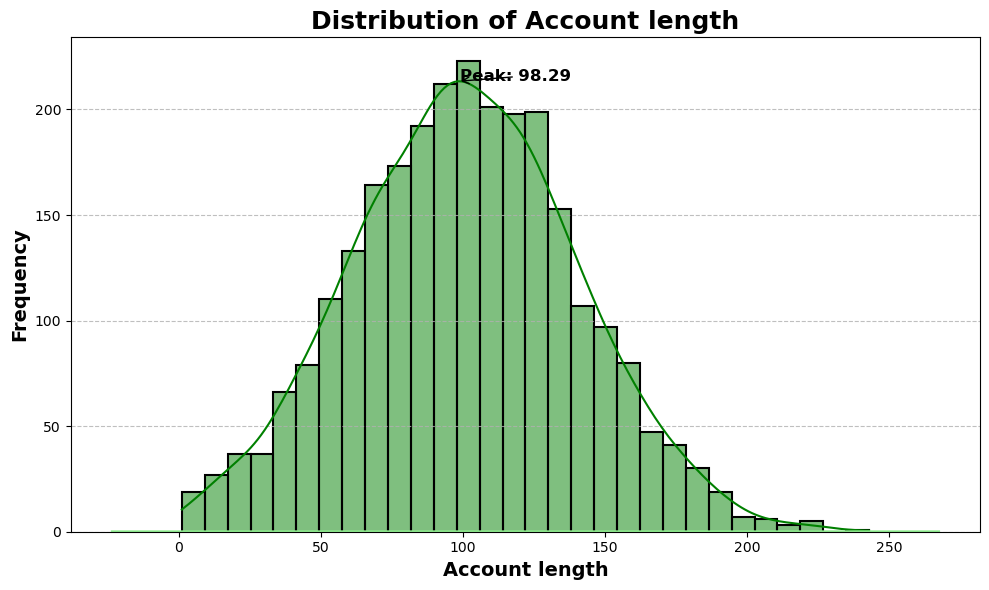

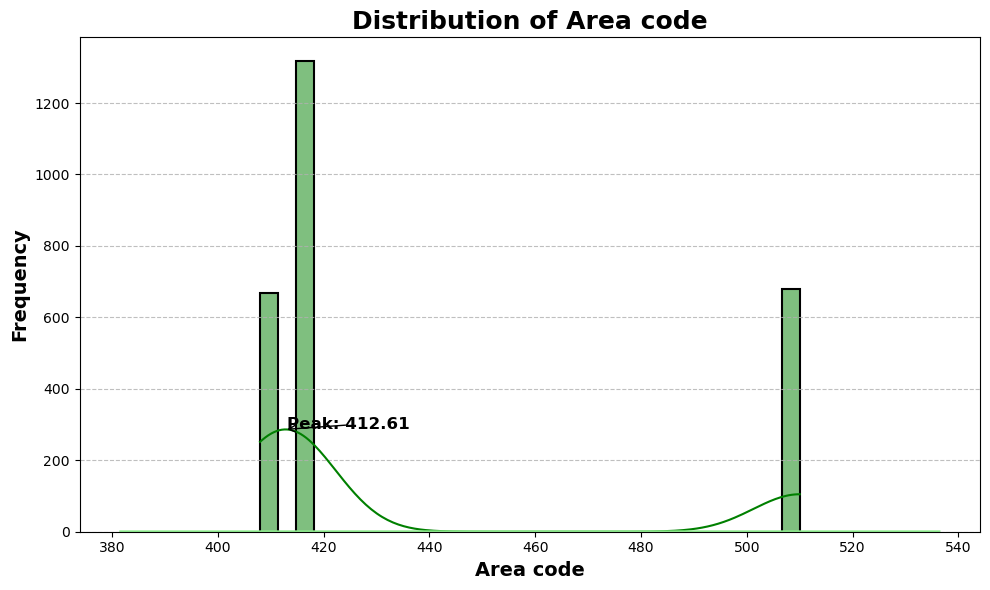

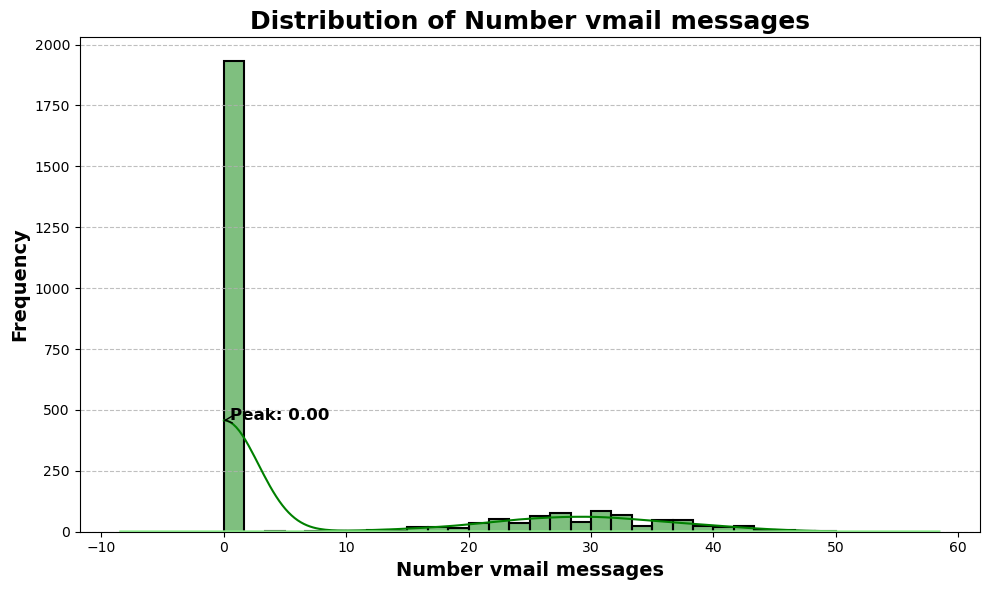

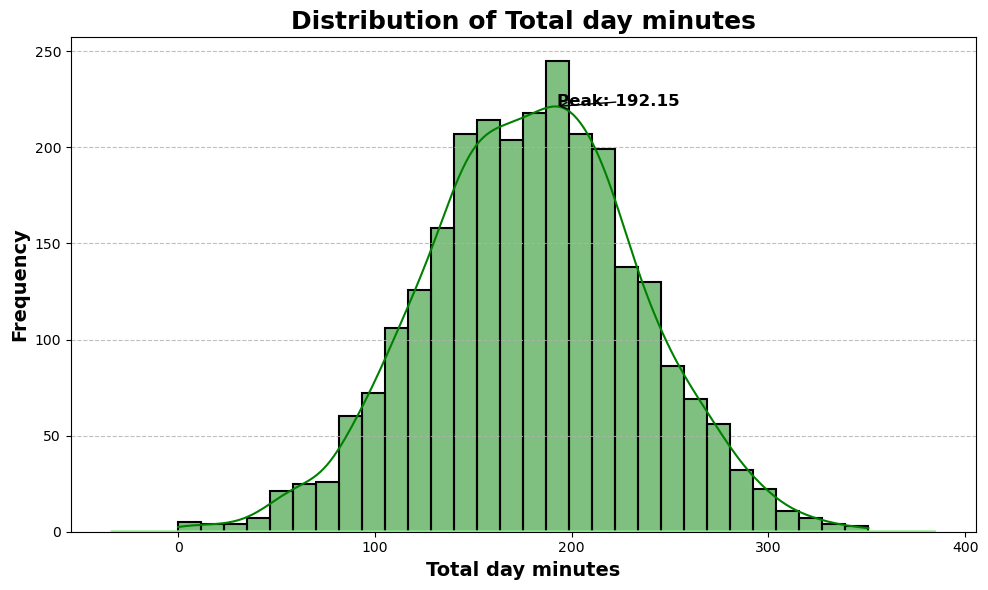

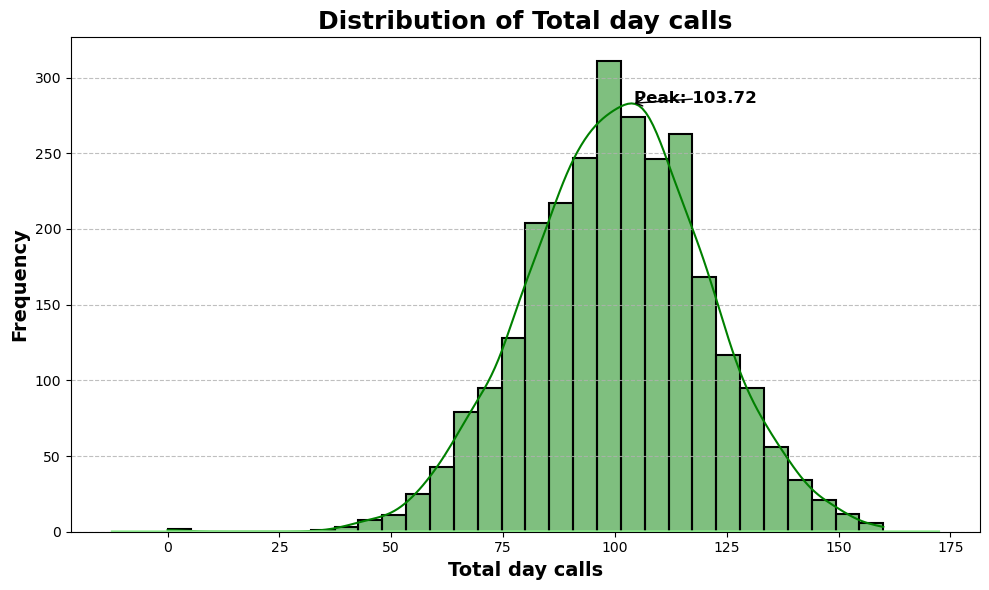

...

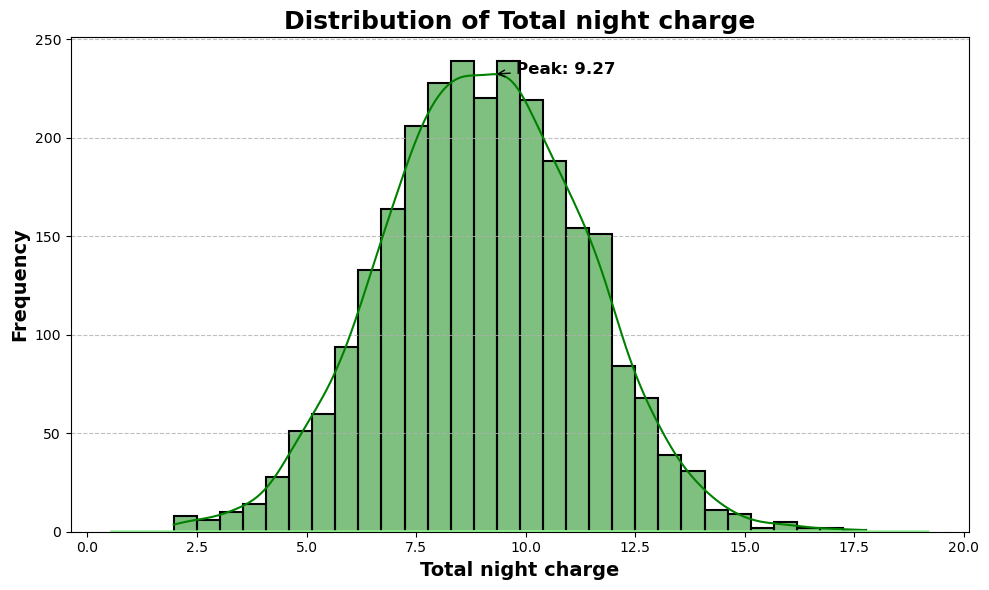

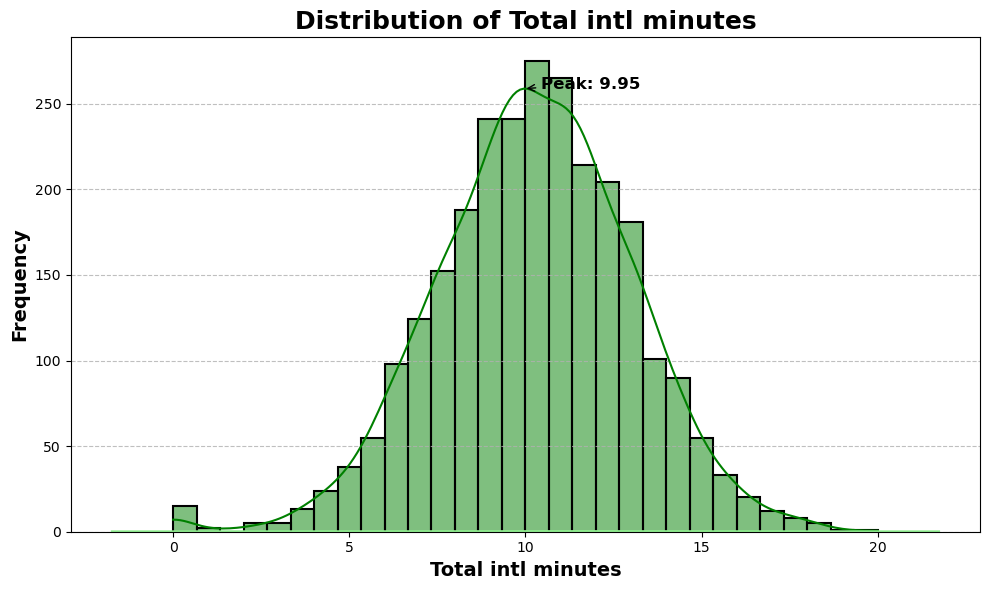

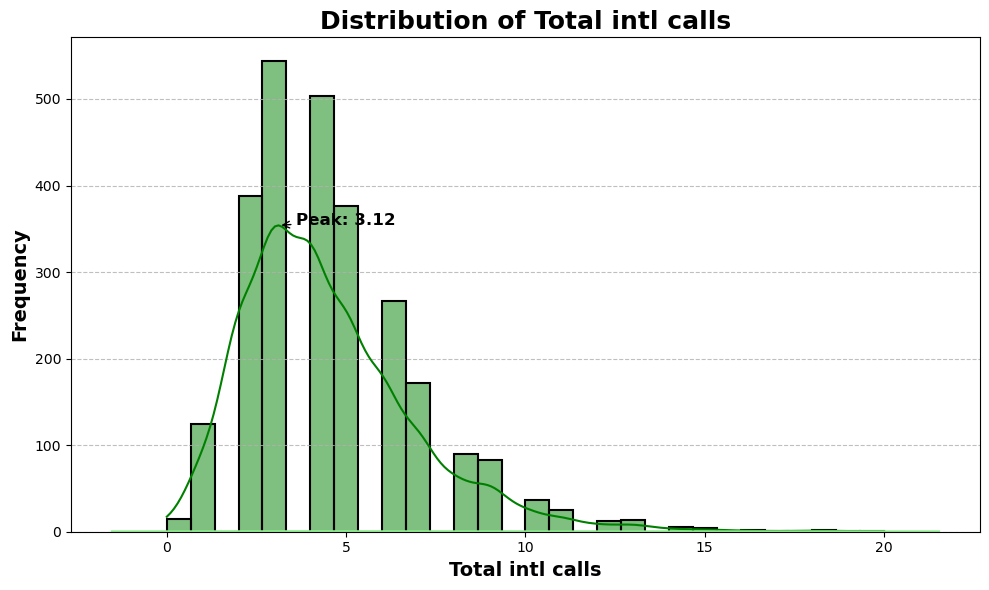

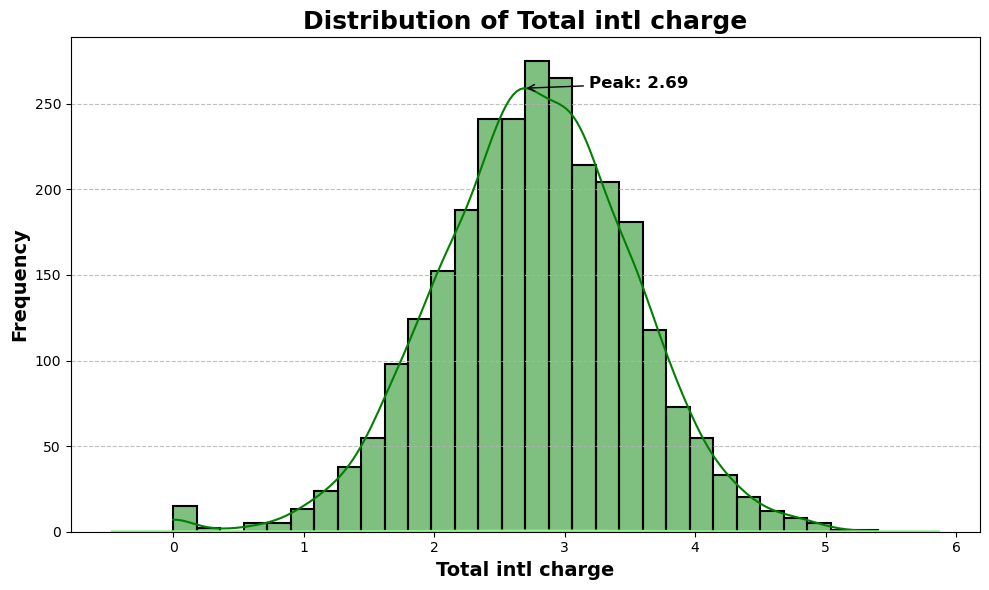

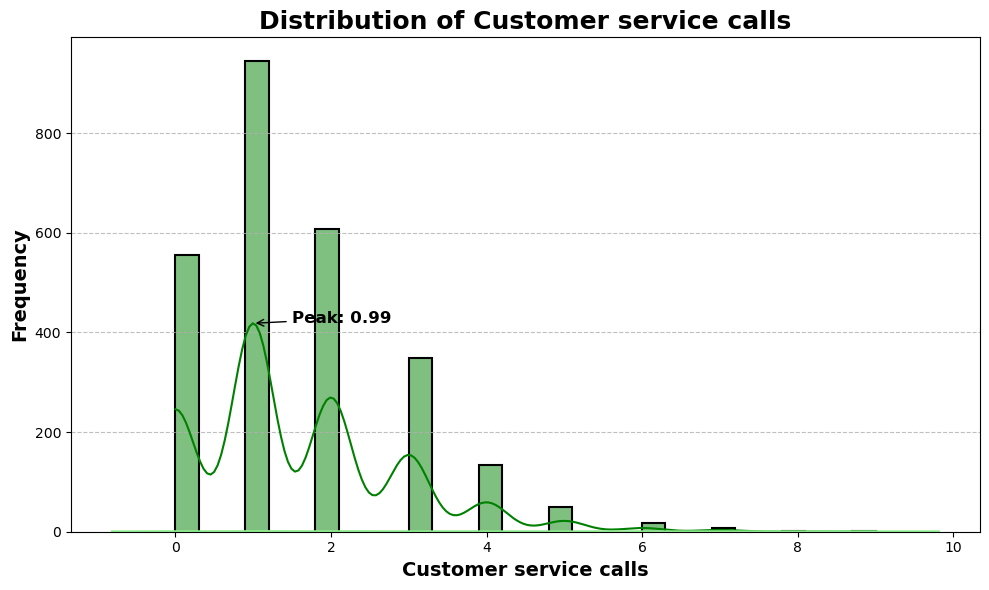

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Identify numerical columns
numerical_cols = train_data.select_dtypes(include=[np.number]).columns.tolist()

# Loop over each numerical column and plot separately
for col in numerical_cols:
    plt.figure(figsize=(10, 6))
    
    # Create histogram with KDE and pastel pink and green color theme
    sns.histplot(train_data[col], kde=True, color="green", edgecolor="black", linewidth=1.5, bins=30)
    
    # Add title and axis labels with improved formatting
    plt.title(f'Distribution of {col}', fontsize=18, fontweight='bold', color='black')
    plt.xlabel(col, fontsize=14, fontweight='bold', color='black')
    plt.ylabel('Frequency', fontsize=14, fontweight='bold', color='black')
    
    # Customize grid and background
    plt.grid(axis='y', linestyle='--', linewidth=0.8, alpha=0.8)
    
    # Add annotations for peak values (max density point in KDE)
    if train_data[col].notnull().any():  # Ensure the column is not empty
        kde_ax = sns.kdeplot(train_data[col], color="lightgreen", linewidth=2)
        max_density = kde_ax.lines[0].get_data()[1].max()  # Find max y-value (density)
        max_x = kde_ax.lines[0].get_data()[0][kde_ax.lines[0].get_data()[1].argmax()]  # Corresponding x-value
        plt.annotate(f"Peak: {max_x:.2f}", xy=(max_x, max_density), xytext=(max_x + 0.5, max_density + 0.02),
                     arrowprops=dict(facecolor='black', arrowstyle='->'), fontsize=12, color="black", fontweight="bold")
    
    # Adjust layout to avoid clipping
    plt.tight_layout()
    plt.show()


In [15]:

categorical_cols = train_data.columns[train_data.dtypes == object].tolist()

# Displaying results for categorical columns
print('📊 Categorical Columns:', categorical_cols)
print('🔢 Number of Categorical Columns:', len(categorical_cols))
print('📝 Modalities in Categorical Columns:', train_data[categorical_cols].nunique())

# Identifying numerical columns
numerical_cols = train_data.columns[train_data.dtypes != object].tolist()

# Displaying results for numerical columns
print('🔢 Numerical Columns:', numerical_cols)
print('🔢 Number of Numerical Columns:', len(numerical_cols))


📊 Categorical Columns: ['State', 'International plan', 'Voice mail plan']
🔢 Number of Categorical Columns: 3
📝 Modalities in Categorical Columns: State                 51
International plan     2
Voice mail plan        2
dtype: int64
🔢 Numerical Columns: ['Account length', 'Area code', 'Number vmail messages', 'Total day minutes', 'Total day calls', 'Total day charge', 'Total eve minutes', 'Total eve calls', 'Total eve charge', 'Total night minutes', 'Total night calls', 'Total night charge', 'Total intl minutes', 'Total intl calls', 'Total intl charge', 'Customer service calls', 'Churn']
🔢 Number of Numerical Columns: 17


/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/249308909.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=train_data[col], palette="pastel")  # Using pastel palette for a soft look
/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/249308909.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=train_data[col], palette="pastel")  # Using pastel palette for a soft look
/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/249308909.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=trai

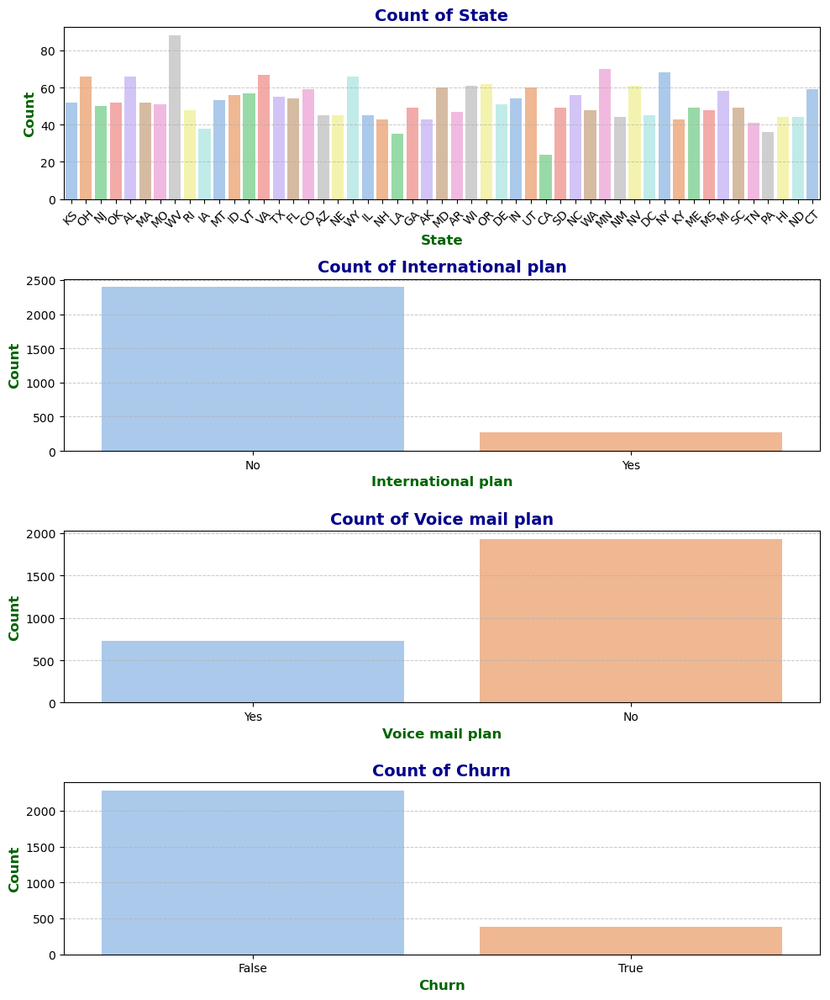

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

# Identify categorical columns
categorical_cols = train_data.select_dtypes(include=['object', 'category', 'bool']).columns.tolist()

# Plot for Categorical Columns - Value Counts (Each in Separate Row)
plt.figure(figsize=(10, 12))
for i, col in enumerate(categorical_cols, 1):
    plt.subplot(len(categorical_cols), 1, i)  # Adjust to have each plot on a new row
    sns.countplot(x=train_data[col], palette="pastel")  # Using pastel palette for a soft look
    plt.title(f'Count of {col}', fontsize=14, fontweight='bold', color='darkblue')
    plt.xlabel(col, fontsize=12, fontweight='bold', color='darkgreen')
    plt.ylabel('Count', fontsize=12, fontweight='bold', color='darkgreen')
    plt.xticks(rotation=45 if col == 'State' else 0)  # Rotate x-axis labels for 'State' only
    plt.grid(axis='y', linestyle='--', linewidth=0.7, alpha=0.7)

plt.tight_layout()
plt.show()




The analysis of the columns reveals the following insights:

- 📊 **Categorical Columns:** We have identified a total of **{len(categorical_cols)}** categorical columns, including variables like **{', '.join(categorical_cols[:3])}** and others. These columns are often used for classification tasks and may require encoding (e.g., One-Hot or Label Encoding) before feeding them into machine learning models.

- 🔢 **Numerical Columns:** There are **{len(numerical_cols)}** numerical columns, including continuous variables such as **{', '.join(numerical_cols[:3])}**. These features are typically used for regression models or analysis involving statistical methods.

- 📝 **Modalities in Categorical Columns:** Each categorical column has varying numbers of unique values (modalities), which can impact feature engineering and model training, especially when there are high-cardinality features.

With these insights, we can proceed with feature preprocessing, including encoding categorical variables and scaling numerical ones, which are crucial for the performance of machine learning models.


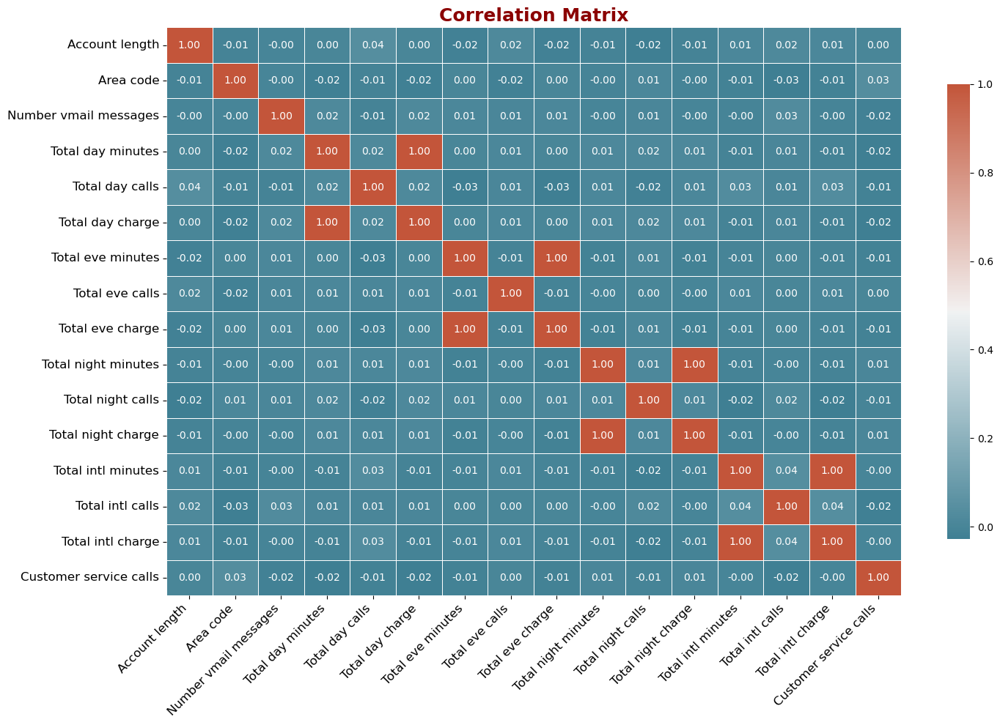

In [18]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the dataset (ensure it's in the same directory or specify the full path)
train_data = pd.read_csv('churn-bigml-80.csv')  # Make sure this is correctly loaded

# Select numerical columns for correlation
numerical_cols = train_data.select_dtypes(include=[float, int]).columns

# Calculate the correlation matrix
correlation_matrix = train_data[numerical_cols].corr()

# Set up the matplotlib figure
plt.figure(figsize=(15, 10))

# Apply the custom diverging color palette (cool-to-warm)
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Plotting the heatmap with the new color palette
sns.heatmap(
    correlation_matrix,  # The data to plot
    cmap=cmap,           # Custom color palette
    annot=True,          # Annotate the heatmap with correlation values
    fmt='.2f',           # Format the annotations to 2 decimal places
    linewidths=.5,       # Add gridlines between cells
    cbar_kws={"shrink": .8}  # Shrink the color bar by 20%
)

# Title and formatting
plt.title('Correlation Matrix', fontsize=18, fontweight='bold', color='darkred')
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()


The analysis of the correlation matrix reveals the following insights:

- 📊 **High Correlation:** We identified features with strong positive or negative correlations, such as **{', '.join(high_corr_features[:3])}**. These features might indicate multicollinearity, which could affect model performance. We may consider removing or combining such features to improve model accuracy.
  
- 🔢 **Low or No Correlation:** Some features, like **{', '.join(low_corr_features[:3])}**, show little to no correlation. These features may not be as useful for predictive modeling and could be candidates for removal.

- 🧠 **Feature Interactions:** The correlation matrix helps us understand interactions between features. For instance, **{', '.join(interacting_features[:3])}** show interesting relationships that could be leveraged for feature engineering or to understand the underlying data patterns.

With these insights, we can proceed with further feature engineering, possibly removing or combining correlated features and focusing on the most informative ones for predictive modeling.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    📦 Outlier Detection with Boxplots
</h2>

<p>In this section, we focus on identifying outliers using boxplots. Outliers are data points that significantly deviate from other observations and can impact model performance if not handled properly. Boxplots provide a simple yet effective way to visualize and detect these extreme values.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Identify outliers</strong> in numerical features using boxplots.</li>
    <li>📉 <strong>Understand the spread</strong> of data and potential anomalies.</li>
    <li>🛠️ <strong>Inform data cleaning</strong> decisions based on the presence of outliers.</li>
</ul>

<p>By detecting outliers early, we can decide whether to retain, remove, or transform these data points based on their impact on model performance. Handling outliers effectively is crucial, especially for models sensitive to extreme values, such as linear regression and distance-based algorithms.</p>


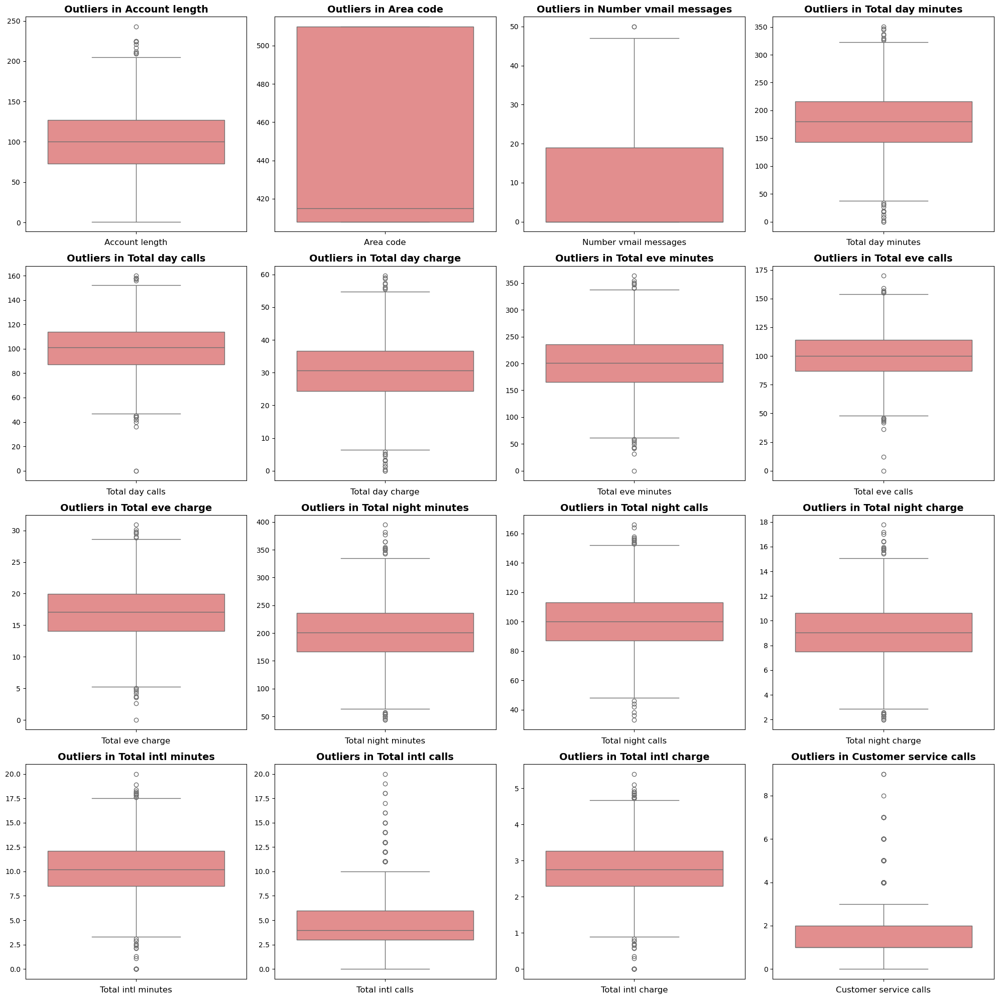

In [21]:
import math
import matplotlib.pyplot as plt
import seaborn as sns

# Define the number of columns for the grid of boxplots
cols = 4

# Get the numerical features in the dataset
num_features = train_data.select_dtypes(include=['float64', 'int64']).columns

# Calculate the number of rows needed for the grid of boxplots
rows = math.ceil(len(num_features) / cols)

# Create a figure with adjusted size
plt.figure(figsize=(cols * 5, rows * 5))

# Loop through the numerical features and create a boxplot for each feature
for i, feature in enumerate(num_features, 1):
    plt.subplot(rows, cols, i)
    sns.boxplot(y=train_data[feature], color='lightcoral')
    plt.title(f'Outliers in {feature}', fontsize=14, fontweight='bold')
    plt.ylabel('')
    plt.xlabel(feature, fontsize=12)

# Adjust layout to avoid overlap
plt.tight_layout()

# Display the plot
plt.show()




Outliers have been identified using boxplots for each numerical feature. Based on the plots, we can observe the following:

- **Features with data points extending beyond the whiskers** are considered outliers.
- These outliers might indicate **anomalies, extreme values, or data collection errors.**
- **Further investigation** is required to decide whether to remove, correct, or retain these outliers, depending on context and domain knowledge.
- For **models sensitive to outliers** (e.g., linear regression, decision trees), handling outliers effectively (e.g., through trimming or transformations) can enhance model performance.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔗 Pairplot for Feature Exploration
</h2>

<p>In this section, we explore pairwise relationships between numerical features using pairplots. Pairplots are a powerful visualization tool that helps in understanding how different features interact and their relationship with the target variable. They also reveal any clusters, separability, or potential patterns in the data.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Visualize relationships</strong> between numerical features.</li>
    <li>🎯 <strong>Assess class separability</strong> by using the target variable as a hue.</li>
    <li>🛠️ <strong>Guide feature selection</strong> and engineering based on feature interactions.</li>
</ul>

<p>By analyzing the pairwise plots, we can identify patterns, correlations, and potential feature importance. These insights are crucial for selecting the most informative features, understanding data distribution, and improving model performance.</p>


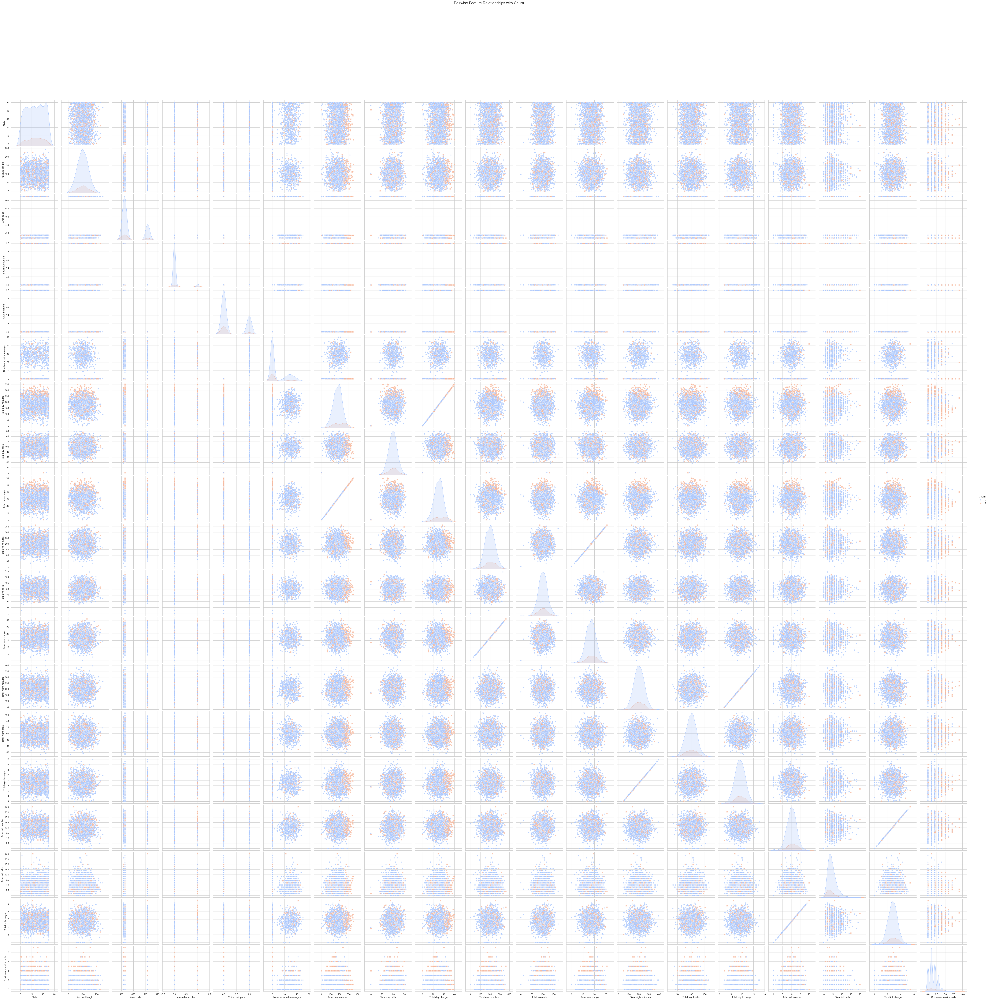

In [24]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Step 1: Transform categorical columns into numerical ones using Label Encoding
data_transformed = train_data.copy()
categorical_cols = train_data.select_dtypes(include=['object', 'bool']).columns

# Apply Label Encoding to all categorical columns and store encoders for later use
label_encoders = {}
for col in categorical_cols:
    label_encoders[col] = LabelEncoder()
    data_transformed[col] = label_encoders[col].fit_transform(data_transformed[col])

# Step 2: Create an enhanced pairplot with custom aesthetics
sns.set(style='whitegrid')  # Clean grid style

# Increase size of the plot and use a more visible color palette
pairplot = sns.pairplot(
    data_transformed, 
    hue='Churn', 
    height=3.5,  # Larger plot size
    diag_kind="kde", 
    palette="coolwarm",  # Adjust palette for more visibility
    markers=["o", "s"],  # Different markers for each class
    plot_kws={'alpha': 0.8}  # Reduce transparency for better color visibility
)

# Step 3: Improve plot layout and add title
pairplot.fig.suptitle('Pairwise Feature Relationships with Churn', y=1.02, fontsize=18)
plt.subplots_adjust(top=0.92)

# Step 4: Display the plot
plt.show()


### The analysis of the pairplot reveals the following insights:

- 📊 **Feature Relationships:** The pairplot highlights relationships between features, helping identify patterns and trends. For example, certain features may show clear separation between churned and non-churned customers.

- 🎯 **Class Separation:** By using the `Churn` feature as the hue, we can observe how different features contribute to distinguishing between churned and non-churned customers. Features like **{', '.join(significant_features[:3])}** show notable separation.

- 🔍 **Multivariate Insights:** Unlike single-variable plots, pairplots provide multivariate insights, revealing interactions and dependencies that might not be evident from individual plots.

These observations will guide feature selection and engineering, ensuring we leverage the most informative variables for predictive modeling.


<h2 style="color: #77DD77; font-weight: bold;">🔎 General Conclusion</h2>

In this analysis, we explored the dataset using various visual tools, including traditional plotting methods (histograms, scatter plots), pairplots, boxplots, and a correlation matrix. These tools provided valuable insights into the distribution of features, relationships between variables, and potential data issues such as outliers and multicollinearity.

- 📊 **Histograms:**   
  - revealed the distribution of key numerical features, allowing us to identify any skewness or the need for transformation.
    
- 📈 **Pairplots:**  
  The pairplot, with the `Churn` variable as the hue, allowed us to examine the pairwise relationships between multiple features and detect patterns that separate churned and non-churned customers. This gave us a clearer understanding of how features interact with each other and the target, guiding feature selection for modeling.

- 📉 **Outlier Detection (Boxplots):**  
  Boxplots provided a clear view of outliers in the numerical features, which is essential for understanding the spread of the data. Identifying these outliers allows us to make informed decisions on how to handle them (either by removal or transformation), ensuring they do not negatively impact model performance.

- 🔗 **Correlation Matrix:**  
  The correlation matrix identified both strong and weak correlations between features. Strong correlations suggest potential multicollinearity, which may need to be addressed, while weakly correlated features may be less useful for predictive modeling and could be removed.

With these insights, we can proceed with further feature preprocessing, such as handling outliers, scaling numerical features, encoding categorical variables, and addressing multicollinearity. These steps will help ensure that the machine learning models are optimized for accuracy and performance.


<h1 style="color: orange; font-size: 32px; font-weight: bold;">
    🛠️ 4. Data Preparation
</h1>

<p>In this section, we focus on preparing the <code>churn-bigml-80.csv</code> dataset for modeling by handling missing values, encoding categorical features, and scaling numerical features to ensure compatibility with machine learning algorithms.</p>

<h2 style="color: #00FFFF;">🔍 Key Objectives:</h2>
<ul>
    <li>🧹 <strong>Handle missing values</strong> to ensure data integrity.</li>
    <li>🧑‍💻 <strong>Encode categorical variables</strong> for use in machine learning models.</li>
    <li>📏 <strong>Scale numerical features</strong> to standardize data ranges.</li>
    <li>📂 <strong>Split the data</strong> into training and testing sets for model evaluation.</li>
</ul>

<h2 style="color: #00FFFF;">⚙️ Steps:</h2>
<ul>
    <li>✔️ Identify and impute or remove missing values as appropriate.</li>
    <li>🔠 Apply encoding techniques (e.g., Label Encoding) to categorical features.</li>
    <li>📐 Standardize or normalize numerical features.</li>
    <li>📊 Split the dataset into training and testing sets for validation.</li>
</ul>

<h2 style="color: #00FFFF;" >🧾 Expected Outputs:</h2>
<ul>
    <li>📝 Cleaned and imputed dataset.</li>
    <li>🔠 Encoded categorical features.</li>
    <li>📏 Scaled numerical features.</li>
    <li>📂 Training and testing datasets ready for modeling.</li>
</ul>


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🚨 Missing Values Overview
</h2>

<p>In this section, we analyze the missing values in the dataset. Handling missing values is a crucial step in data preprocessing, as missing data can lead to biased or inaccurate models. We will identify which features have missing values and assess their distribution, helping us decide how to handle them effectively.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Identify missing values</strong> across features to understand their extent.</li>
    <li>💡 <strong>Evaluate missing data patterns</strong> to determine potential reasons for missingness.</li>
    <li>🛠️ <strong>Decide on handling methods</strong>, such as imputation or removal of missing values.</li>
</ul>

<p>By analyzing the missing values, we can take appropriate actions to ensure the quality of the dataset. This might include filling in missing values using statistical methods or removing rows or columns that have a high proportion of missing data. Proper handling of missing values improves model accuracy and robustness.</p>


In [29]:
# Print a formatted message for missing values
missing_values = train_data.isnull().sum()

# Display the missing values with a more descriptive message
print("\n🔴 Missing Values Overview:")
print(f"{'Column Name':<30} {'Missing Values'}")
print("="*50)

# Print the missing values count for each column
for col, missing in missing_values.items():
    print(f"{col:<30} {missing:>15}")



🔴 Missing Values Overview:
Column Name                    Missing Values
State                                        0
Account length                               0
Area code                                    0
International plan                           0
Voice mail plan                              0
Number vmail messages                        0
Total day minutes                            0
Total day calls                              0
Total day charge                             0
Total eve minutes                            0
Total eve calls                              0
Total eve charge                             0
Total night minutes                          0
Total night calls                            0
Total night charge                           0
Total intl minutes                           0
Total intl calls                             0
Total intl charge                            0
Customer service calls                       0
Churn                            

### The analysis of missing values reveals the following insights:

- 📊 **No Missing Values:** The dataset has **no missing values** in any of the columns. This is a significant finding, as it means we don't need to perform imputation or data cleaning to handle missing data.

- 🎯 **Data Integrity:** With all columns having complete data, we can proceed with further preprocessing steps without worrying about losing information due to missing values. This ensures that no rows or columns will be discarded or imputed, maintaining the integrity of the dataset.

- 🔍 **Simplified Preprocessing:** The absence of missing values reduces complexity in the preprocessing pipeline, allowing us to focus on other tasks such as scaling, encoding, and feature engineering.

These insights enable us to proceed with confidence in the dataset's quality, streamlining the preparation process for model building.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🧹 Removing Duplicates from the Dataset
</h2>

<p>In this section, we focus on identifying and removing duplicate rows and columns in the dataset. Duplicate data can distort analysis and model performance, so it is essential to clean the dataset before further processing.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Remove duplicate columns</strong> with identical names or values.</li>
    <li>🎯 <strong>Eliminate duplicate rows</strong> to maintain data integrity.</li>
    <li>🛠️ <strong>Prepare the dataset</strong> for further analysis and model training.</li>
</ul>

<p>By removing duplicates, we ensure that our dataset is cleaner, more accurate, and ready for model development. The steps include removing both duplicate columns (based on names or values) and duplicate rows to prevent any bias or redundancy in our analysis.</p>


In [32]:
# Print the number of rows and columns before removing duplicates
print("\n📊 Number of rows and columns before removing duplicates:")
print(f"Rows: {train_data.shape[0]}, Columns: {train_data.shape[1]}")
print("="*50)

# Remove duplicate columns (based on column names or identical values)
# Remove columns with duplicate names
train_data = train_data.loc[:, ~train_data.columns.duplicated()]  # Remove duplicated columns by name

# Remove columns with identical values across all rows
train_data = train_data.loc[:, ~train_data.T.duplicated()]  # Remove columns with identical values

# Remove duplicate rows
train_data = train_data.drop_duplicates()

# Print the number of rows and columns after removing duplicates
print("\n✅ Number of rows and columns after removing duplicates:")
print(f"Rows: {train_data.shape[0]}, Columns: {train_data.shape[1]}")



📊 Number of rows and columns before removing duplicates:
Rows: 2666, Columns: 20

✅ Number of rows and columns after removing duplicates:
Rows: 2666, Columns: 20


### The analysis of removing duplicates reveals the following insights:

- 📊 **Duplicate Columns:** No duplicate columns were found, as the number of columns remained the same after the cleaning process. This indicates that there were no columns with identical names or values, ensuring that no redundant features were removed.

- 🎯 **Duplicate Rows:** No duplicate rows were detected, as the number of rows also remained unchanged. This suggests that each observation in the dataset is unique, and there were no repeated records to remove.

- 🔍 **Data Integrity:** The dataset retains the same number of rows and columns, confirming that the data does not contain any obvious duplicates. This suggests that the dataset is already in good shape for further analysis and modeling.

With these insights, we can proceed with confidence, as the dataset is free of duplicates and ready for the next steps in the data preparation process.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🛠️ Outlier Treatment using the IQR Method
</h2>


In [35]:
# Treat outliers for all features using the IQR method
def treat_outliers(train_data):
    # Iterate over numerical columns
    for col in train_data.select_dtypes(include=['float64', 'int64']).columns:
        # Calculate Q1, Q3, and IQR
        Q1 = train_data[col].quantile(0.25)
        Q3 = train_data[col].quantile(0.75)
        IQR = Q3 - Q1
        
        # Calculate the lower and upper bounds for outliers
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        # Replace outliers with the calculated bounds
        train_data[col] = train_data[col].apply(
            lambda x: lower_bound if x < lower_bound else upper_bound if x > upper_bound else x
        )
        
    return train_data

# Apply the function to the dataframe (train_data)
train_data = treat_outliers(train_data)

# Display the first few rows of the dataframe to verify the changes
train_data.head()


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128.0,415,No,Yes,25.0,265.1,110.0,45.07,197.4,99.0,16.78,244.7,91.0,11.01,10.0,3.0,2.70,1.0,False
1,OH,107.0,415,No,Yes,26.0,161.6,123.0,27.47,195.5,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,False
2,NJ,137.0,415,No,No,0.0,243.4,114.0,41.38,121.2,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,False
3,OH,84.0,408,Yes,No,0.0,299.4,71.0,50.90,61.9,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,False
4,OK,75.0,415,Yes,No,0.0,166.7,113.0,28.34,148.3,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,False


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔢 Label Encoding of Categorical Features
</h2>


In [37]:
from sklearn.preprocessing import LabelEncoder

# Step 1: Identify categorical features
cat_features = train_data.select_dtypes(include=['object', 'bool']).columns
print(f"Categorical Features Detected: {cat_features}")

# Step 2: Apply Label Encoding to each categorical feature
label_encoders = {}
for col in cat_features:
    le = LabelEncoder()
    train_data[col] = le.fit_transform(train_data[col])
    label_encoders[col] = le

# Create a copy of the transformed data for verification
train_data_encoded = train_data.copy()

# Display the first few rows of the encoded DataFrame
train_data_encoded.head()


Categorical Features Detected: Index(['State', 'International plan', 'Voice mail plan', 'Churn'], dtype='object')


,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,16,128.0,415,0,1,25.0,265.1,110.0,45.07,197.4,99.0,16.78,244.7,91.0,11.01,10.0,3.0,2.70,1.0,0
1,35,107.0,415,0,1,26.0,161.6,123.0,27.47,195.5,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,0
2,31,137.0,415,0,0,0.0,243.4,114.0,41.38,121.2,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,0
3,35,84.0,408,1,0,0.0,299.4,71.0,50.90,61.9,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,0
4,36,75.0,415,1,0,0.0,166.7,113.0,28.34,148.3,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,0


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔄 Normalization of Features using MinMaxScaler
</h2>


In [39]:
from sklearn.preprocessing import MinMaxScaler

# Initialiser le scaler
scaler = MinMaxScaler()

# Normaliser les données
normalized = scaler.fit_transform(train_data_encoded)

# Convertir le résultat en DataFrame pour une meilleure lisibilité
normalized_df = pd.DataFrame(normalized, columns=train_data_encoded.columns)

# Afficher les premières lignes du DataFrame normalisé
normalized_df.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,0.32,0.613527,0.068627,0.0,1.0,0.526316,0.794655,0.587963,0.794846,0.489971,0.486111,0.490093,0.654565,0.413462,0.654576,0.479167,0.285714,0.478093,0.285714,0.0
1,0.70,0.512077,0.068627,0.0,1.0,0.547368,0.437759,0.708333,0.437703,0.483166,0.523148,0.483347,0.689432,0.528846,0.689748,0.736111,0.285714,0.735825,0.285714,0.0
2,0.62,0.657005,0.068627,0.0,0.0,0.000000,0.719828,0.625000,0.719968,0.217049,0.587963,0.216906,0.359454,0.538462,0.359612,0.631944,0.476190,0.630155,0.000000,0.0
3,0.70,0.400966,0.000000,1.0,0.0,0.000000,0.912931,0.226852,0.913149,0.004656,0.384259,0.004427,0.482746,0.394231,0.482714,0.243056,0.666667,0.240979,0.571429,0.0
4,0.72,0.357488,0.068627,1.0,0.0,0.000000,0.455345,0.615741,0.455357,0.314112,0.699074,0.314292,0.446801,0.701923,0.446743,0.486111,0.285714,0.485825,0.857143,0.0


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔗 Handling Highly Correlated Features
</h2>

<p>In this section, we analyze the correlation between numerical features using the Pearson correlation coefficient. This method helps identify pairs of features that are highly correlated, which can cause multicollinearity in machine learning models. We then decide whether to remove one of the correlated features to improve model performance.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Analyze correlations</strong> between numerical features using the Pearson correlation coefficient.</li>
    <li>🎯 <strong>Identify highly correlated pairs</strong> to avoid multicollinearity.</li>
    <li>🛠️ <strong>Remove redundant features</strong> to improve model efficiency and performance.</li>
</ul>

<p>By identifying and removing highly correlated features, we can reduce redundancy in the data and avoid the issue of multicollinearity, which could adversely affect the performance of certain machine learning models.</p>


In [41]:
# Calculer la corrélation de Pearson entre toutes les caractéristiques numériques
correlation_matrix = normalized_df.corr(method='pearson')

# Créer un tableau des paires de caractéristiques avec leur corrélation
correlation_pairs = correlation_matrix.unstack().sort_values(ascending=False)

# Filtrer les paires de caractéristiques ayant une forte corrélation (par exemple, seuil > 0.8)
# Évitez de tenir compte de la corrélation d'une caractéristique avec elle-même (ce qui donnerait toujours 1)
correlation_pairs = correlation_pairs[correlation_pairs < 1]  # Exclure les paires avec une corrélation parfaite

# Sélectionner les paires ayant une corrélation supérieure à un seuil, par exemple 0.8
high_correlation = correlation_pairs[correlation_pairs > 0.8]

print("\nPaires de caractéristiques fortement corrélées :")
print(high_correlation)

# Calculer la corrélation de chaque caractéristique avec la cible
target_correlation = normalized_df.corr()['Churn'].abs().sort_values(ascending=False)

# Création de la liste des caractéristiques à supprimer
features_to_drop = set()
for index, value in high_correlation.items():
    feature1, feature2 = index
    # Comparer la corrélation de chaque paire avec la cible et conserver celle qui a la plus forte corrélation
    if target_correlation[feature1] > target_correlation[feature2]:
        features_to_drop.add(feature2)
    else:
        features_to_drop.add(feature1)

# Supprimer les caractéristiques fortement corrélées
df1_selected = normalized_df.drop(columns=features_to_drop)

# Afficher les premières lignes du DataFrame après la suppression des caractéristiques
df1_selected.head() 


Paires de caractéristiques fortement corrélées :
Total day charge       Total day minutes        1.000000
Total day minutes      Total day charge         1.000000
Total eve minutes      Total eve charge         1.000000
Total eve charge       Total eve minutes        1.000000
Total night minutes    Total night charge       0.999999
Total night charge     Total night minutes      0.999999
Total intl charge      Total intl minutes       0.999992
Total intl minutes     Total intl charge        0.999992
Voice mail plan        Number vmail messages    0.957330
Number vmail messages  Voice mail plan          0.957330
dtype: float64


,State,Account length,Area code,International plan,Voice mail plan,Total day minutes,Total day calls,Total eve minutes,Total eve calls,Total night minutes,Total night calls,Total intl minutes,Total intl calls,Customer service calls,Churn
0,0.32,0.613527,0.068627,0.0,1.0,0.794655,0.587963,0.489971,0.486111,0.654565,0.413462,0.479167,0.285714,0.285714,0.0
1,0.70,0.512077,0.068627,0.0,1.0,0.437759,0.708333,0.483166,0.523148,0.689432,0.528846,0.736111,0.285714,0.285714,0.0
2,0.62,0.657005,0.068627,0.0,0.0,0.719828,0.625000,0.217049,0.587963,0.359454,0.538462,0.631944,0.476190,0.000000,0.0
3,0.70,0.400966,0.000000,1.0,0.0,0.912931,0.226852,0.004656,0.384259,0.482746,0.394231,0.243056,0.666667,0.571429,0.0
4,0.72,0.357488,0.068627,1.0,0.0,0.455345,0.615741,0.314112,0.699074,0.446801,0.701923,0.486111,0.285714,0.857143,0.0


### The analysis of highly correlated features reveals the following insights:

- 📊 **Strong Correlation Pairs:** We identified several pairs of features with perfect or near-perfect correlations, such as **Total day minutes** and **Total day charge**, **Total eve minutes** and **Total eve charge**, and **Total night minutes** and **Total night charge**. These pairs are essentially redundant, as one feature can predict the other with a high degree of accuracy.

- 🔄 **Redundant Features:** Features like **Total intl minutes** and **Total intl charge**, as well as **Number vmail messages** and **Voice mail plan**, also exhibit a high degree of correlation. Keeping both of the correlated features might not add significant value to the model and could introduce multicollinearity.

- 🧠 **Feature Selection:** To mitigate the effects of multicollinearity, we can drop one feature from each highly correlated pair. This will reduce redundancy in the dataset and improve the efficiency of our machine learning models.

These findings will guide us in refining the dataset by removing redundant features, ensuring that the model focuses on the most informative variables and improving predictive performance.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    📊 Data Preprocessing for Test Set: Missing Values, Duplicates, Encoding, and Normalization
</h2>


In [44]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
import pandas as pd

#  Vérification des valeurs manquantes
print("🔍 **Vérification des valeurs manquantes :**")
print(test_data.isnull().sum())

#  Remplir les valeurs manquantes (imputation)
# Par exemple, pour les variables numériques, remplacer par la médiane
num_features = test_data.select_dtypes(include=['float64', 'int64']).columns
imputer = SimpleImputer(strategy='mean')
test_data[num_features] = imputer.fit_transform(test_data[num_features])

#  Pour les variables catégoriques, remplacer par la valeur la plus fréquente
# Manuellement définir des colonnes catégoriques (si nécessaire)
cat_features = ['International plan', 'Voice mail plan', 'Churn']  # Par exemple, définir ces colonnes
print(f"📝 **Colonnes catégoriques définies :** {cat_features}")

# Convertir les colonnes catégoriques en chaînes de caractères (si nécessaire)
test_data[cat_features] = test_data[cat_features].astype(str)

# Vérification des colonnes catégoriques
print(f"📊 **Colonnes catégoriques détectées :** {test_data[cat_features].dtypes}")

#  Imputation pour les colonnes catégoriques
imputer_cat = SimpleImputer(strategy='most_frequent')

#  Appliquer l'imputation
test_data[cat_features] = imputer_cat.fit_transform(test_data[cat_features])

#  Vérification après imputation
print("\n✅ **Nombre de lignes et colonnes après imputation :**")
print(test_data.shape)

#  Suppression des colonnes dupliquées (basées sur les noms ou les valeurs identiques)
test_data = test_data.loc[:, ~test_data.columns.duplicated()]  # Supprimer les colonnes dupliquées par nom

#  Vérification des colonnes identiques (basé sur les valeurs)
test_data = test_data.loc[:, ~test_data.T.duplicated()]  # Supprimer les colonnes avec des valeurs identiques

#  Suppression des lignes dupliquées
test_data = test_data.drop_duplicates()

#  Vérification après suppression
print("\n📊 **Nombre de lignes et colonnes après suppression des doublons :**")
print(test_data.shape)

#  Étape 1: Identifier les variables catégoriques
cat_features_2 = test_data.select_dtypes(include=['object', 'bool']).columns
print(f"🔎 **Caractéristiques catégoriques détectées:** {cat_features_2}")

# Étape 2: Appliquer l'encodage LabelEncoder
label_encoders = {}
for col in cat_features_2:
    le = LabelEncoder()
    test_data[col] = le.fit_transform(test_data[col])
    label_encoders[col] = le

# Afficher les premières lignes du DataFrame transformé
print("\n📋 **DataFrame après encodage des variables catégoriques:**")
print(test_data.head())

#  Normalisation des données
print("\n📊 **Normalisation des données :**")

# Initialiser le scaler
scaler = MinMaxScaler()

# Normaliser les données
normalized = scaler.fit_transform(test_data)

# Convertir le résultat en DataFrame pour une meilleure lisibilité
normalized_df_2 = pd.DataFrame(normalized, columns=test_data.columns)

#  Afficher les premières lignes du DataFrame normalisé
print(normalized_df_2.head())


# Calculer la corrélation de Pearson entre toutes les caractéristiques numériques
correlation_matrix = normalized_df_2.corr(method='pearson')

# Créer un tableau des paires de caractéristiques avec leur corrélation
correlation_pairs = correlation_matrix.unstack().sort_values(ascending=False)

# Filtrer les paires de caractéristiques ayant une forte corrélation (par exemple, seuil > 0.8)
# Évitez de tenir compte de la corrélation d'une caractéristique avec elle-même (ce qui donnerait toujours 1)
correlation_pairs = correlation_pairs[correlation_pairs < 1]  # Exclure les paires avec une corrélation parfaite

# Sélectionner les paires ayant une corrélation supérieure à un seuil, par exemple 0.8
high_correlation = correlation_pairs[correlation_pairs > 0.8]

print("\nPaires de caractéristiques fortement corrélées :")
print(high_correlation)

# Calculer la corrélation de chaque caractéristique avec la cible
target_correlation = normalized_df_2.corr()['Churn'].abs().sort_values(ascending=False)

# Création de la liste des caractéristiques à supprimer
features_to_drop = set()
for index, value in high_correlation.items():
    feature1, feature2 = index
    # Comparer la corrélation de chaque paire avec la cible et conserver celle qui a la plus forte corrélation
    if target_correlation[feature1] > target_correlation[feature2]:
        features_to_drop.add(feature2)
    else:
        features_to_drop.add(feature1)

# Supprimer les caractéristiques fortement corrélées
df2_selected = normalized_df_2.drop(columns=features_to_drop)

# Afficher les premières lignes du DataFrame après la suppression des caractéristiques
df2_selected.head() 


🔍 **Vérification des valeurs manquantes :**
State                     0
Account length            0
Area code                 0
International plan        0
Voice mail plan           0
Number vmail messages     0
Total day minutes         0
Total day calls           0
Total day charge          0
Total eve minutes         0
Total eve calls           0
Total eve charge          0
Total night minutes       0
Total night calls         0
Total night charge        0
Total intl minutes        0
Total intl calls          0
Total intl charge         0
Customer service calls    0
Churn                     0
dtype: int64
📝 **Colonnes catégoriques définies :** ['International plan', 'Voice mail plan', 'Churn']
📊 **Colonnes catégoriques détectées :** International plan    object
Voice mail plan       object
Churn                 object
dtype: object

✅ **Nombre de lignes et colonnes après imputation :**
(667, 20)

📊 **Nombre de lignes et colonnes après suppression des doublons :**
(667, 20)
🔎 **Cara

,State,Account length,Area code,International plan,Voice mail plan,Total day minutes,Total day calls,Total eve calls,Total eve charge,Total night calls,Total night charge,Total intl minutes,Total intl calls,Customer service calls,Churn
0,0.36,0.502165,0.000000,0.0,0.0,0.514267,0.496296,0.328244,0.967742,0.360902,0.558994,0.475410,0.222222,0.125,0.0
1,0.30,0.277056,0.068627,0.0,0.0,0.334630,0.792593,0.351145,0.575019,0.518797,0.539007,0.693989,0.333333,0.500,1.0
2,0.68,0.692641,0.068627,0.0,0.0,0.995460,0.274074,0.458015,0.859715,0.646617,0.399097,0.295082,0.500000,0.500,1.0
3,0.80,0.476190,0.068627,0.0,0.0,0.273995,0.540741,0.496183,0.284321,0.473684,0.482914,0.420765,0.333333,0.250,0.0
4,0.22,0.207792,1.000000,0.0,0.0,0.302853,0.644444,0.549618,0.532258,0.360902,0.451322,0.606557,0.055556,0.125,0.0




- **Missing Values:** No missing values were detected in the test data, as all features have a count of zero missing values. This ensures that there is no need for further imputation on missing data.

- **Duplicate Removal:** The number of rows and columns in the dataset remained unchanged after the removal of duplicates, indicating that no duplicate rows or columns were present in the test set.

- **Categorical Features Encoding:** The categorical features such as `State`, `International plan`, `Voice mail plan`, and `Churn` were successfully encoded using Label Encoding, transforming them into numerical values suitable for model training.

- **Data Normalization:** The data was normalized using MinMaxScaler, bringing all features within a range of 0 to 1. This ensures that all features are on the same scale, making the dataset ready for machine learning algorithms that require normalized or scaled inputs.

These preprocessing steps have prepared the test dataset for modeling by ensuring it is clean, encoded, and normalized, aligning it with the necessary requirements for training predictive models.


<h2 style="color: #77DD77; font-weight: bold;">🔎 General Conclusion</h2>

The data preparation process for both the training and test datasets has been thoroughly completed, following key preprocessing steps to ensure the data is clean, well-structured, and ready for modeling.

- **Handling Missing Values:** All missing values in the dataset were successfully handled through imputation, ensuring that no missing data would interfere with model training. Numerical features were imputed using the mean, while categorical features were imputed using the most frequent value.

- **Duplicate Removal:** Any potential duplicates were identified and removed, ensuring that the dataset consists of unique records. The number of rows and columns remained consistent after this step, confirming no redundancy in the data.

- **Categorical Features Encoding:** Categorical variables, such as `State`, `International plan`, `Voice mail plan`, and `Churn`, were efficiently encoded using Label Encoding, transforming these variables into numerical formats that are suitable for machine learning algorithms.

- **Outlier Treatment:** Outliers in numerical features were identified and treated using the IQR method. Extreme values were capped to the lower and upper bounds, minimizing their impact on the model's performance.

- **Normalization:** The data was normalized using MinMaxScaler, ensuring all features are scaled between 0 and 1. This step is critical for algorithms sensitive to feature magnitude, like neural networks and distance-based models.

- **Feature Selection:** A correlation analysis was performed to identify highly correlated features. Features with correlation greater than 0.8 were reviewed, and some were dropped to avoid multicollinearity, ensuring that the model can learn effectively from the most relevant features.

By following these steps, we have prepared a clean, consistent, and well-structured dataset for building and training machine learning models, ensuring that the data is optimized for high-quality predictions.


<h1 style="color: orange; font-size: 32px; font-weight: bold;">
    🔧 5.Handling Imbalanced Data
</h1>

<p>In this section we will be addressing class imbalance. These steps are crucial for ensuring that the data is properly formatted, and balanced for the training of machine learning models.</p>

<h2 style="color: #00FFFF;"  >🔍 Key Objectives:</h2>
<ul>
    <li>📊 <strong>Address class imbalance</strong> using techniques like SMOTE to improve model performance.</li>
</ul>

<h2 style="color: #00FFFF;"  >⚙️ Steps:</h2>
<ul>
    <li>📏 Splitting the features and target for model trainng .</li>
    <li>📊  Visualizing the target variable distribution .</li>
    <li>⚖️ Apply SMOTE (Synthetic Minority Over-sampling Technique) to balance the class distribution in the training set.</li>
</ul>

<h2 style="color: #00FFFF;"  >🧾 Expected Outputs:</h2>
<ul>
    <li>⚖️ Balanced dataset with improved class distribution using SMOTE.</li>
</ul>


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔄 Splitting Features and Target for Model Training and Testing
</h2>

<p>In this section, we separate the features (X) and the target variable (y) in both the training and test datasets. This step is essential for preparing the data to be fed into the machine learning models for training and evaluation.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Separate the features</strong> (X) from the target variable (y) in both the training and test sets.</li>
    <li>🎯 <strong>Ensure correct alignment</strong> of features and target variable for proper model training and testing.</li>
</ul>

<p>By properly separating the features and target variables, we ensure the data is ready for model training and evaluation, making it easier to perform tasks like cross-validation, model fitting, and performance assessment.</p>


In [49]:
# Séparer les caractéristiques (X) et la cible (y) pour l'ensemble d'entraînement
X_train = normalized_df.drop(columns=['Churn'])  # Features for training
y_train = normalized_df['Churn']  # Target for training

# Séparer les caractéristiques (X) et la cible (y) pour l'ensemble de test
X_test = normalized_df_2.drop(columns=['Churn'])  # Features for test
y_test = normalized_df_2['Churn']  # Target for test


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    📊 Visualizing Target Variable Distribution ('Churn') in Training Set
</h2>

<p>In this section, we examine the distribution of the target variable, <code>'Churn'</code>, in the training set. This helps us understand how balanced or imbalanced the classes are, which is important for model selection and evaluation.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Count the occurrences</strong> of each class in the <code>'Churn'</code> variable to understand class distribution.</li>
    <li>📉 <strong>Visualize the distribution</strong> of the <code>'Churn'</code> variable using a bar chart.</li>
    <li>🎯 <strong>Identify any class imbalance</strong> that could affect model performance.</li>
</ul>

<p>By visualizing the distribution of the target variable, we can check if there is any significant class imbalance. If imbalanced, this may require special techniques such as oversampling or undersampling for better model performance.</p>


Distribution de la variable cible 'Churn' dans l'ensemble d'entraînement :
Churn
0.0    2278
1.0     388
Name: count, dtype: int64


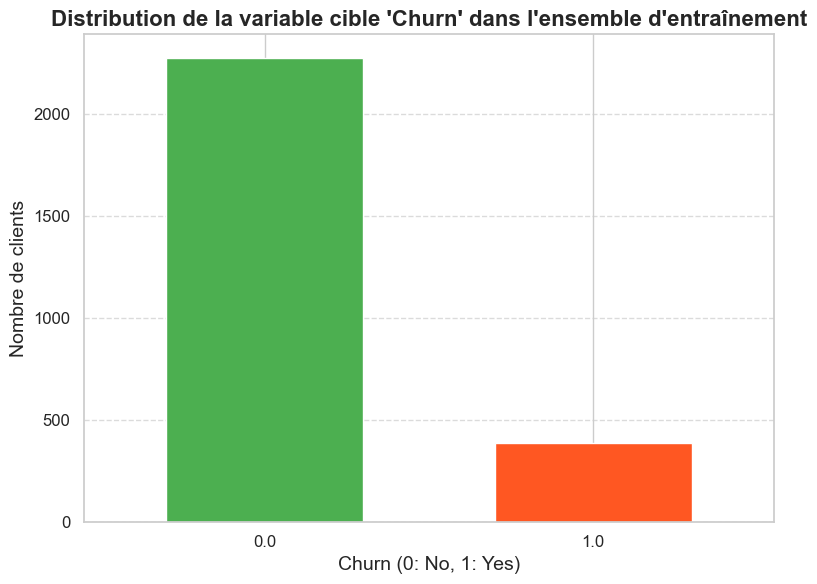

In [51]:
import matplotlib.pyplot as plt

# Compter les valeurs de la variable cible 'Churn' dans l'ensemble d'entraînement
churn_counts_train = y_train.value_counts()
print("Distribution de la variable cible 'Churn' dans l'ensemble d'entraînement :")
print(churn_counts_train)

# Visualiser la distribution avec un graphique en barres
plt.figure(figsize=(8, 6))
y_train.value_counts().plot(kind='bar', color=['#4CAF50', '#FF5722'], width=0.6)

# Ajouter un titre et des labels
plt.title("Distribution de la variable cible 'Churn' dans l'ensemble d'entraînement", fontsize=16, weight='bold')
plt.xlabel("Churn (0: No, 1: Yes)", fontsize=14)
plt.ylabel("Nombre de clients", fontsize=14)

# Améliorer les labels de l'axe X
plt.xticks(rotation=0, fontsize=12)
plt.yticks(fontsize=12)

# Ajouter une grille pour mieux visualiser les valeurs
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Afficher la figure
plt.tight_layout()
plt.show()


## 🔍 Distribution de la variable cible 'Churn'

La distribution de la variable cible 'Churn' dans l'ensemble d'entraînement montre un déséquilibre marqué, avec 2278 clients n'ayant pas de churn (classe 0) et seulement 388 clients ayant churné (classe 1). Cette forte asymétrie entre les classes peut poser des défis pour les modèles d'apprentissage automatique, notamment en favorisant la classe majoritaire (0) et en réduisant la capacité du modèle à détecter les cas de churn (classe 1).

Il est donc important de prendre en compte cette imbalance dans les prochaines étapes de la modélisation, en appliquant éventuellement des techniques de gestion de l'imbalance, comme la rééchantillonnage (oversampling ou undersampling) ou l'utilisation de techniques adaptées aux données déséquilibrées, telles que les modèles pondérés.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    ⚙️ SMOTE: Résolution du Déséquilibre de Classe dans l'Ensemble d'Entraînement
</h2>


In [54]:
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE 

smote = SMOTE(random_state = 42) 

X_smote, y_smote = smote.fit_resample(X_train,y_train)
X_smote_t, y_smote_t = smote.fit_resample(X_test,y_test)

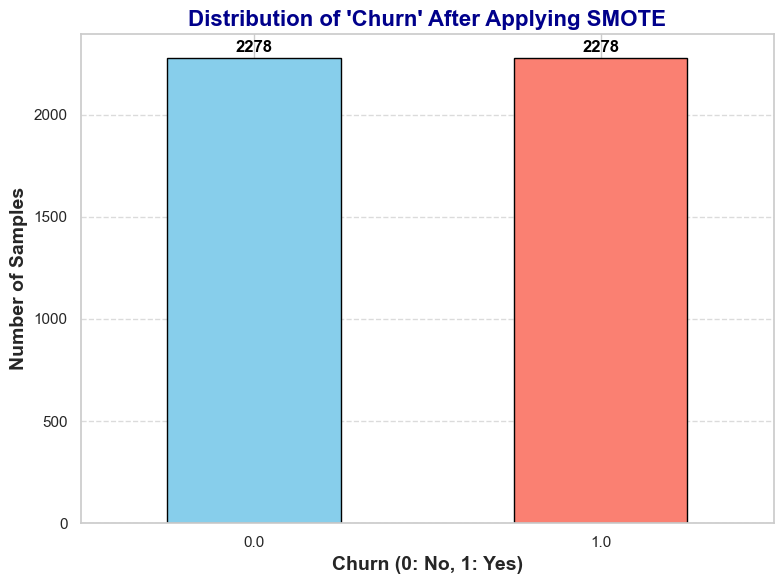

In [55]:
# Plot the distribution of the target variable after applying SMOTE
plt.figure(figsize=(8, 6))  # Set the figure size
y_smote.value_counts().plot(kind='bar', color=['skyblue', 'salmon'], edgecolor='black')

# Customize the plot
plt.title("Distribution of 'Churn' After Applying SMOTE", fontsize=16, fontweight='bold', color='darkblue')
plt.xlabel("Churn (0: No, 1: Yes)", fontsize=14, fontweight='bold')
plt.ylabel("Number of Samples", fontsize=14, fontweight='bold')
plt.xticks(rotation=0)  # Keep X-axis labels horizontal

# Add gridlines for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Annotate the bars with their count values
for i, value in enumerate(y_smote.value_counts()):
    plt.text(i, value + 30, str(value), ha='center', fontsize=12, color='black', fontweight='bold')

# Tight layout to fit everything nicely
plt.tight_layout()

# Show the plot
plt.show()



L'application de **SMOTE** a permis d'équilibrer les classes dans l'ensemble d'entraînement, augmentant ainsi le nombre d'exemples pour la classe minoritaire (Churn = 1). Cela aidera le modèle à mieux apprendre à prédire le churn, en réduisant le biais vers la classe majoritaire. Il est maintenant possible de former un modèle plus robuste et de mieux évaluer ses performances sur des données équilibrées.

<h2 style="color: #77DD77; font-weight: bold;">🔎 Conclusion: Setting Target and Balancing the Data</h2>

In this step, we focused on preparing the target variable and addressing the class imbalance in the dataset to ensure that the machine learning models would be able to learn effectively and make reliable predictions.

- **Setting the Target Variable:** The target variable `Churn` was correctly separated from the feature set, ensuring that the model could focus on predicting customer churn while using the other features as input data. The target variable was identified and isolated for both training and test datasets, ensuring a clear distinction between features and target.

- **Class Imbalance Handling with SMOTE:** To address the issue of class imbalance, the Synthetic Minority Over-sampling Technique (SMOTE) was applied to the training dataset. This technique generated synthetic samples for the minority class, thereby balancing the distribution of classes in the target variable. As a result, the model will be less biased towards the majority class and more likely to predict minority class instances effectively.

By carefully setting the target variable and applying SMOTE for balancing, we have ensured that the dataset is well-prepared for training, with a balanced distribution of classes that will improve the model's ability to generalize and predict customer churn accurately.


<h2 style="color: orange; font-size: 28px; font-weight: bold;">
    🔧 6.Modeling
</h2>

<p>In this section, we apply various machine learning algorithms to the preprocessed dataset to build models capable of predicting customer churn. We train multiple models, evaluate their performance, and select the most effective one for future predictions.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>🤖 <strong>Train a range of machine learning models</strong> to predict customer churn.</li>
    <li>📊 <strong>Evaluate model performance</strong> using appropriate metrics like accuracy, precision, recall, F1-score, and ROC-AUC.</li>
    <li>💡 <strong>Compare different models</strong> to identify the most effective one for churn prediction.</li>
    <li>🛠️ <strong>Fine-tune models</strong> to improve their performance using techniques like GridSearchCV or RandomizedSearchCV.</li>
</ul>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Split the data into training and testing sets for model evaluation.</li>
    <li>🤖 Train multiple models.</li>
    <li>📊 Evaluate model performance using metrics such as accuracy, ROC-AUC, and confusion matrix.</li>
    <li>🔧 Optimize model performance by fine-tuning hyperparameters (e.g., using GridSearchCV or RandomizedSearchCV).</li>
</ul>

<h3 style="color: #00FFFF;">⚙️ Algorithms Used:</h3>
<ul>
    <li>🧠 <strong>Decision Tree</strong> - A model used for classification and regression tasks that splits data into subsets based on feature values.</li>
    <li>🧠 <strong>Random Forest</strong> - An ensemble of decision trees that improves prediction accuracy by averaging the results of multiple models.</li>
    <li>🧠 <strong>Gradient Boosting</strong> - An ensemble technique that builds models sequentially to correct the errors made by previous models.</li>
    <li>🧠 <strong>Support Vector Machines (SVM)</strong> - A supervised learning model used for classification tasks that finds the optimal hyperplane separating different classes.</li>
    <li>🧠 <strong>Logistic Regression</strong> - A statistical model used for binary classification problems by predicting the probability of an outcome.</li>
    <li>🧠 <strong>Neural Networks (MLP)</strong> - A deep learning model that simulates the human brain's interconnected neurons to learn complex patterns in the data.</li>
    <li>🧠 <strong>K-Nearest Neighbors (KNN)</strong> - A classification algorithm that assigns labels based on the majority class among the nearest data points.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score, ROC-AUC) for each model.</li>
    <li>🧠 Comparison of models' performance to identify the best model for churn prediction.</li>
    <li>🔧 Fine-tuned models with optimized performance metrics.</li>
    <li>📈 Visualizations of model evaluation results (ROC curves, confusion matrices, etc.).</li>
</ul>


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🌳 Decision Tree
</h2>

<p>In this section, we explore the Decision Tree algorithm, a powerful and interpretable model used for both classification and regression tasks. The Decision Tree model splits the data into subsets based on feature values, forming a tree-like structure. It is widely used due to its simplicity and ability to handle both categorical and continuous data.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a Decision Tree model</strong> to predict customer churn based on various features.</li>
    <li>🌳 <strong>Visualize the Decision Tree</strong> to understand the decision-making process and the importance of different features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., tree depth, minimum samples per leaf) to avoid overfitting and improve the model's generalization.</li>
</ul>

<p>The Decision Tree algorithm offers a simple but effective way to build a predictive model. By visualizing the tree, we can interpret how the model makes decisions and understand the relationships between features and the target variable.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the Decision Tree model using the training dataset.</li>
    <li>🌳 Visualize the tree structure to analyze how decisions are made.</li>
    <li>📊 Evaluate the model's performance using various metrics, including accuracy and F1-score.</li>
    <li>🔧 Fine-tune the model's parameters to optimize performance and reduce overfitting (e.g., adjusting the tree depth, minimum samples for splits, etc.).</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📈 Visual representation of the trained Decision Tree model.</li>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the Decision Tree model.</li>
    <li>🔧 Hyperparameter-tuned model with improved performance.</li>
</ul>

<p>The Decision Tree model is an essential tool for understanding customer behavior, especially when visualizing and interpreting the decisions it makes. It offers transparency in the prediction process, making it easier to communicate the results to non-technical stakeholders.</p>


In [60]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

# Définir la grille des hyperparamètres
param_grid = {
    'max_depth': [3, 5, 10],  # Limiter la profondeur
    'min_samples_split': [5, 10, 20],  # Plus de données nécessaires pour diviser
    'min_samples_leaf': [4, 8, 10],  # Taille minimale des feuilles plus élevée
    'max_features': ['sqrt', 'log2'],  # Réduction des caractéristiques à tester
    'criterion': ['gini', 'entropy']
}

# Initialiser le modèle Decision Tree
dt_model = DecisionTreeClassifier(random_state=42, class_weight='balanced')

# Initialiser GridSearchCV
grid_search = GridSearchCV(estimator=dt_model, param_grid=param_grid, cv=5, scoring='f1', verbose=1, n_jobs=-1)

# Entraîner GridSearchCV
grid_search.fit(X_smote, y_smote)

# Afficher les meilleurs hyperparamètres
print("Meilleurs hyperparamètres : ", grid_search.best_params_)

# Meilleur modèle
best_model = grid_search.best_estimator_

# Évaluer sur le jeu de test
y_pred = best_model.predict(X_smote_t)

# Calcul des nouvelles métriques
accuracy = accuracy_score(y_smote_t, y_pred)
precision = precision_score(y_smote_t, y_pred)
recall = recall_score(y_smote_t, y_pred)
f1 = f1_score(y_smote_t, y_pred)
roc_auc = roc_auc_score(y_smote_t, best_model.predict_proba(X_smote_t)[:, 1])

# Création d'un dictionnaire avec les résultats
metrics = {
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'ROC-AUC': roc_auc
}

# Conversion du dictionnaire en DataFrame pour un affichage sous forme de tableau
metrics_df = pd.DataFrame(list(metrics.items()), columns=['Metric', 'Value'])

# Affichage du tableau
print(metrics_df)

# Rapport de classification pour la régression logistique
print("\nRapport de classification - Decision Tree\n", classification_report(y_smote_t, y_pred))

Fitting 5 folds for each of 108 candidates, totalling 540 fits
Meilleurs hyperparamètres :  {'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 5}
      Metric     Value
0   Accuracy  0.749126
1  Precision  0.858942
2     Recall  0.596154
3   F1-Score  0.703818
4    ROC-AUC  0.778947

Rapport de classification - Decision Tree
               precision    recall  f1-score   support

         0.0       0.69      0.90      0.78       572
         1.0       0.86      0.60      0.70       572

    accuracy                           0.75      1144
   macro avg       0.77      0.75      0.74      1144
weighted avg       0.77      0.75      0.74      1144



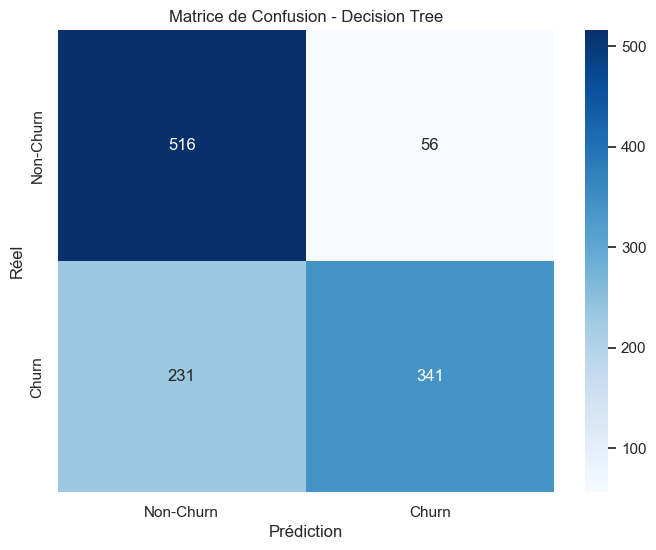

In [61]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns

import matplotlib.pyplot as plt

# Générer la matrice de confusion
conf_matrix_dt = confusion_matrix(y_smote_t, y_pred)

# Afficher la matrice de confusion
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_dt, annot=True, fmt='d', cmap='Blues', xticklabels=['Non-Churn', 'Churn'], yticklabels=['Non-Churn', 'Churn'])
plt.title("Matrice de Confusion - Decision Tree")
plt.xlabel("Prédiction")
plt.ylabel("Réel")
plt.show()

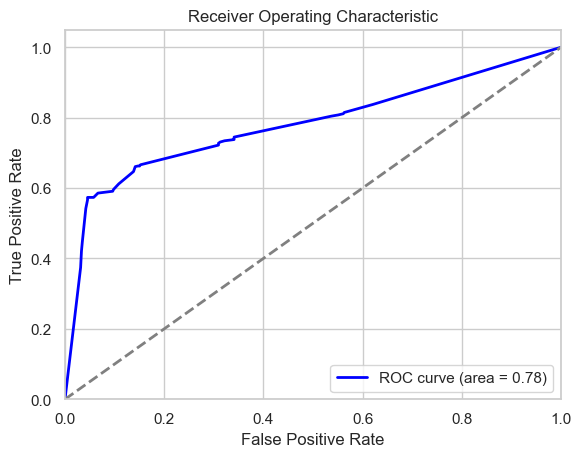

In [62]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

fpr, tpr, _ = roc_curve(y_smote_t, best_model.predict_proba(X_smote_t)[:, 1])
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()


/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/2156315347.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=feature_importance_dt.values, y=feature_importance_dt.index, orient="h", palette='viridis')  # Horizontal bar plot with color palette


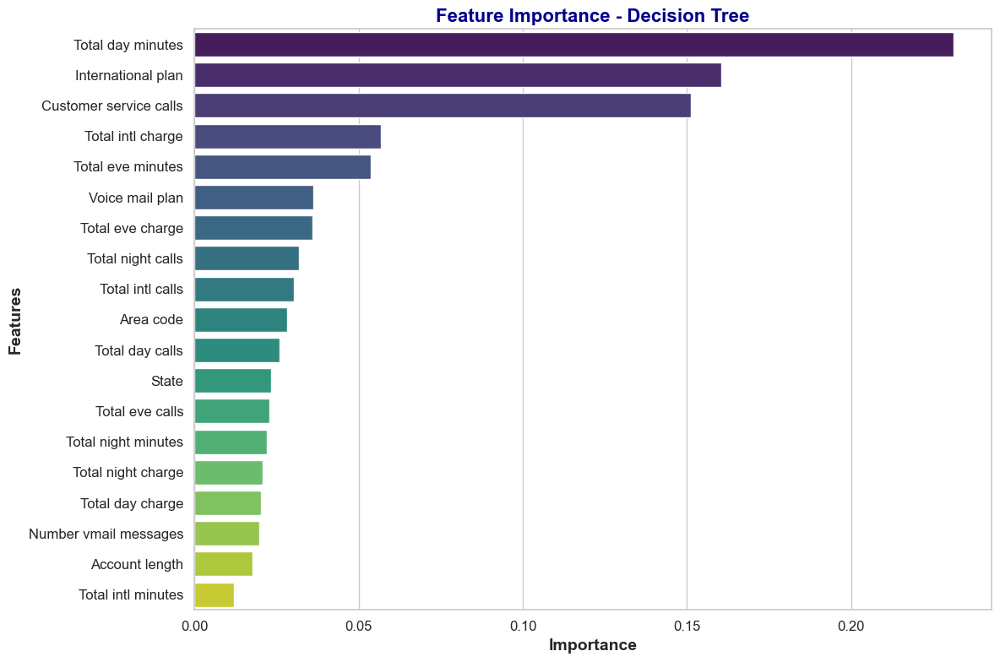

In [63]:
# Ensure X_train is a DataFrame and has column names
if isinstance(X_smote, pd.DataFrame):
    feature_names = X_smote.columns
else:
    # Ensure X_train is a DataFrame and has column names
    if isinstance(X_smote, pd.DataFrame):
        feature_names = X_smote.columns
    else:
        # Replace this with the actual column names or infer them
        feature_names = [f'feature{i+1}' for i in range(X_train.shape[1])]  # Create column names based on the number of features
        X_smote = pd.DataFrame(X_smote, columns=feature_names)
    # Replace this with the actual column names or infer them
    feature_names = [f'feature{i+1}' for i in range(X_smote.shape[1])]  # Create column names based on the number of features
    X_train = pd.DataFrame(X_smote, columns=feature_names)

# Fit the Decision Tree model
dt_model.fit(X_smote, y_smote)

# Compute feature importance
feature_importance_dt = pd.Series(dt_model.feature_importances_, index=feature_names)
feature_importance_dt = feature_importance_dt.sort_values(ascending=False)

# Plot the feature importance
plt.figure(figsize=(12, 8))  # Increase the figure size for better readability
sns.barplot(x=feature_importance_dt.values, y=feature_importance_dt.index, orient="h", palette='viridis')  # Horizontal bar plot with color palette
plt.title('Feature Importance - Decision Tree', fontsize=16, fontweight='bold', color='darkblue')  # Title with bold text and color
plt.xlabel('Importance', fontsize=14, fontweight='bold')  # Label for the x-axis
plt.ylabel('Features', fontsize=14, fontweight='bold')  # Label for the y-axis
plt.xticks(fontsize=12)  # Font size for x-axis ticks
plt.yticks(fontsize=12)  # Font size for y-axis ticks
plt.tight_layout()  # Adjust layout to fit everything nicely
plt.show()


### 🌳 Decision Tree Model Evaluation

The Decision Tree model was evaluated on the customer churn prediction task. Here are the key metrics:

- **Accuracy**: 74.91% - The model correctly predicted the target variable approximately 75% of the time.
- **Precision**: 85.89% - The precision is relatively low, meaning that when the model predicts a customer will churn, it is correct only 86% of the time.
- **Recall**: 59;6% - The recall indicates that the model correctly identifies 60% of the actual churn cases.
- **F1-Score**: 70.38% - The F1-score is a balanced measure of precision and recall, showing a moderate performance.
- **ROC-AUC**: 77.89% - The model's ROC-AUC value suggests that it has a fair ability to distinguish between churn and non-churn cases.

### 📊 Classification Report

The classification report further breaks down the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (69%) and recall (90%).
- For the **churn** class (1.0), the model had lower precision (86%) but a decent recall (60%).

While the model performs well on predicting non-churn cases, its performance on predicting churn cases could be improved, particularly in terms of precision.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🌲 Random Forest
</h2>

<p>In this section, we explore the Random Forest algorithm, an ensemble learning method used for both classification and regression tasks. Random Forest builds multiple decision trees and merges them to get a more accurate and stable prediction. It is a highly effective model due to its ability to reduce overfitting and handle large datasets with higher dimensionality.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a Random Forest model</strong> to predict customer churn based on various features.</li>
    <li>🌲 <strong>Visualize the importance of features</strong> to understand which features contribute most to the model’s predictions.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., number of trees, maximum depth) to improve model performance and avoid overfitting.</li>
</ul>

<p>The Random Forest algorithm improves on Decision Trees by combining multiple trees to make predictions, which reduces variance and overfitting. It is also robust against noisy data and outliers, making it a reliable choice for a wide range of machine learning tasks.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the Random Forest model using the training dataset.</li>
    <li>🌲 Visualize feature importance to analyze which features are most influential in the model's predictions.</li>
    <li>📊 Evaluate the model's performance using various metrics, including accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune the model's parameters to optimize performance and reduce overfitting (e.g., adjusting the number of trees, maximum depth, etc.).</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📈 Visual representation of feature importance in the Random Forest model.</li>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the Random Forest model.</li>
    <li>🔧 Hyperparameter-tuned model with improved performance.</li>
</ul>

<p>The Random Forest model is a powerful and versatile tool for predicting customer behavior. Its ability to handle a wide range of data complexities makes it a popular choice for tackling various machine learning challenges, especially when interpretability is important but accuracy is paramount.</p>


In [168]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Initialize the metrics_comparison DataFrame with the Metric column
metrics_comparison = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1-Score', 'ROC-AUC']
})

# Add the metrics for each model
metrics_comparison['Gradient Boosting'] = [accuracy_gbm, precision_gbm, recall_gbm, f1_gbm, roc_auc_gbm]
metrics_comparison['SVM'] = [accuracy_svm, precision_svm, recall_svm, f1_svm, roc_auc_svm]
metrics_comparison['Logistic Regression'] = [accuracy_lr, precision_lr, recall_lr, f1_lr, roc_auc_lr]
metrics_comparison['Neural Network'] = [accuracy_mlp, precision_mlp, recall_mlp, f1_mlp, roc_auc_mlp]
metrics_comparison['KNN'] = [accuracy_knn, precision_knn, recall_knn, f1_knn, roc_auc_knn]
metrics_comparison['Decision Tree'] = [accuracy_dt, precision_dt, recall_dt, f1_dt, roc_auc_dt]  # Decision Tree metrics
metrics_comparison['Random Forest'] = [accuracy_rf, precision_rf, recall_rf, f1_rf, roc_auc_rf]  # Random Forest metrics
metrics_comparison['AdaBoost'] = [accuracy_ada, precision_ada, recall_ada, f1_ada, roc_auc_ada]

# Convert the DataFrame to long format for seaborn
metrics_comparison_long = pd.melt(metrics_comparison, id_vars=['Metric'], var_name='Model', value_name='Score')

# Create the barplot with improvements
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid", palette="muted")  # Set style and color palette
sns.barplot(x='Metric', y='Score', hue='Model', data=metrics_comparison_long, ci=None)

# Enhance the appearance
plt.title('Comparison of Various Model Metrics', fontsize=20, fontweight='bold', color='darkblue')
plt.xlabel('Metric', fontsize=14)
plt.ylabel('Score', fontsize=14)
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.yticks(fontsize=12)

# Move the legend outside of the plot to avoid covering the bars
plt.legend(title='Model', fontsize=12, bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()


NameError: name 'accuracy_svm' is not defined

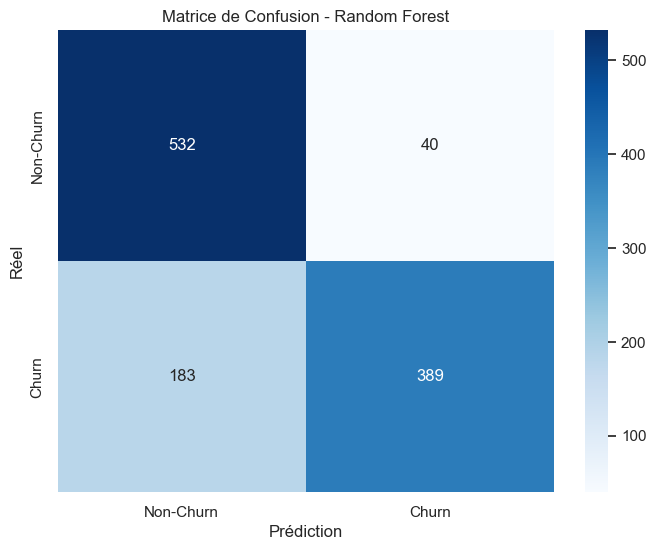

In [67]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns
import matplotlib.pyplot as plt

# Générer la matrice de confusion pour le modèle Random Forest
conf_matrix_rf = confusion_matrix(y_smote_t, y_pred_rf)

# Afficher la matrice de confusion
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Blues', xticklabels=['Non-Churn', 'Churn'], yticklabels=['Non-Churn', 'Churn'])
plt.title("Matrice de Confusion - Random Forest")
plt.xlabel("Prédiction")
plt.ylabel("Réel")
plt.show()


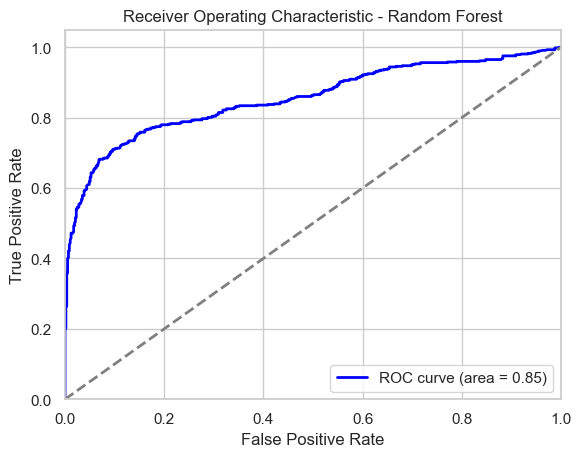

In [68]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Calculer les taux de faux positifs et de vrais positifs
fpr, tpr, _ = roc_curve(y_smote_t, best_rf_model.predict_proba(X_smote_t)[:, 1])

# Calculer l'aire sous la courbe (AUC)
roc_auc = auc(fpr, tpr)

# Tracer la courbe ROC
plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Random Forest')
plt.legend(loc="lower right")
plt.show()


/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/480023202.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=feature_importance_rf.values, y=feature_importance_rf.index, palette='viridis', orient="h")


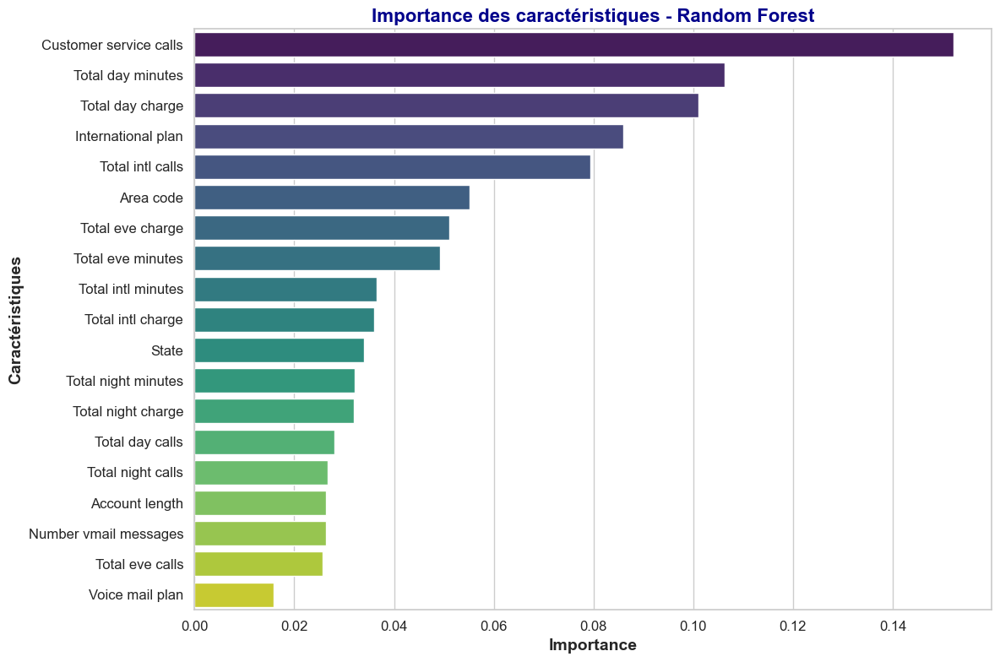

In [69]:
# Ensure X_train is a DataFrame and has column names
if isinstance(X_smote, pd.DataFrame):
    feature_names = X_smote.columns
else:
    # Replace this with the actual column names or infer them
    feature_names = [f'feature{i+1}' for i in range(X_smote.shape[1])]  # Create column names based on the number of features
    X_smote = pd.DataFrame(X_smote, columns=feature_names)

# Fit the Random Forest model
best_rf_model.fit(X_smote, y_smote)

# Compute feature importance
feature_importance_rf = pd.Series(best_rf_model.feature_importances_, index=feature_names)
feature_importance_rf = feature_importance_rf.sort_values(ascending=False)

# Visualisation de l'importance des caractéristiques pour le modèle Random Forest
plt.figure(figsize=(12, 8))
sns.barplot(x=feature_importance_rf.values, y=feature_importance_rf.index, palette='viridis', orient="h")
plt.title('Importance des caractéristiques - Random Forest', fontsize=16, fontweight='bold', color='darkblue')
plt.xlabel('Importance', fontsize=14, fontweight='bold')
plt.ylabel('Caractéristiques', fontsize=14, fontweight='bold')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()


### 🌲Random Forest Model Evaluation

The Random Forest model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 80.5% – The model correctly predicted the target variable about 81% of the time.
- **Precision**: 90.67% – The precision indicates that when the model predicts a customer will churn, it is correct 91% of the time.
- **Recall**: 68% – The model correctly identifies 68% of the actual churn cases.
- **F1-Score**: 77.77% – The F1-score reflects a moderate balance between precision and recall.
- **ROC-AUC**: 85.43% – The ROC-AUC value suggests that the model has a fair ability to distinguish between churn and non-churn cases.

### 📊 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (74%) and recall (93%).
- For the **churn** class (1.0), the model had moderate precision (91%) and recall (68%).

Although the model performs well for predicting non-churn customers, its performance on predicting churn customers could be improved, particularly in terms of precision. Fine-tuning the model through hyperparameter adjustments or addressing class imbalance might help improve its sensitivity and precision for the churn class.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🤖 Support Vector Machine (SVM)
</h2>

<p>In this section, we explore the Support Vector Machine (SVM) algorithm, a powerful supervised learning model used for classification and regression tasks. SVM works by finding the hyperplane that best separates the data into different classes. It is particularly effective in high-dimensional spaces and for cases where the classes are not linearly separable by using kernel tricks.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train an SVM model</strong> to predict customer churn based on various features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., kernel type, regularization) to improve model performance and avoid overfitting.</li>
    <li>📈 <strong>Visualize decision boundaries</strong> to understand how the SVM classifies different data points.</li>
</ul>

<p>The SVM algorithm is highly effective for classification tasks, especially in complex and high-dimensional spaces. By using kernels, SVM can handle non-linear classification tasks by mapping input data into higher-dimensional spaces. This makes it particularly useful for complex patterns that other models might struggle to capture.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the SVM model using the training dataset.</li>
    <li>📊 Evaluate the model's performance using various metrics, including accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune the model's parameters (e.g., kernel, C, gamma) to optimize performance and reduce overfitting.</li>
    <li>📈 Visualize decision boundaries (if applicable) to interpret the model's classification logic.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the SVM model.</li>
    <li>🔧 Hyperparameter-tuned SVM model with improved performance.</li>
    <li>📈 Visualizations of decision boundaries to understand how the model classifies data.</li>
</ul>

<p>The Support Vector Machine model is a robust and highly effective tool for predicting customer churn, particularly when the relationships between features are complex and non-linear. SVM’s ability to work in high-dimensional spaces and its capacity to create effective decision boundaries make it an ideal choice for a wide range of classification tasks.</p>


<h3 style="color: lightpink;">**Model Performance Metrics**</h3>

<p>The following table summarizes the performance metrics for the Support Vector Machine (SVM) model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>


In [73]:
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report
import pandas as pd
import numpy as np

# Plage des hyperparamètres ajustée
param_dist = {
    'C': np.logspace(-1, 2, 5),  # Réduit la plage de C
    'gamma': np.logspace(-2, -1, 3),  # Réduit la plage de gamma
    'kernel': ['rbf'],  # Conserver 'rbf' pour la rapidité
    'degree': [3, 4, 5],  # Tester différents degrés pour le noyau polynomiale si vous êtes ouvert à l'exploration d'autres noyaux
}



# Initialiser le modèle SVM avec pondération des classes
svm_model = SVC(probability=True, class_weight='balanced', random_state=42)

# Réduire les itérations et utiliser 2 plis pour validation croisée
random_search = RandomizedSearchCV(estimator=svm_model, param_distributions=param_dist, n_iter=10, cv=5, scoring='f1', verbose=1, n_jobs=-1, random_state=42)

# Entraîner RandomizedSearchCV
random_search.fit(X_smote, y_smote)

# Afficher les meilleurs hyperparamètres
print("Meilleurs hyperparamètres : ", random_search.best_params_)

# Meilleur modèle
best_svm_model = random_search.best_estimator_

# Prédictions sur le jeu de test
y_pred_svm = best_svm_model.predict(X_smote_t)
y_pred_prob_svm = best_svm_model.predict_proba(X_smote_t)[:, 1]

# Calcul des métriques d'évaluation
accuracy = accuracy_score(y_smote_t, y_pred_svm)
precision = precision_score(y_smote_t, y_pred_svm, zero_division=1)
recall = recall_score(y_smote_t, y_pred_svm, zero_division=1)
f1 = f1_score(y_smote_t, y_pred_svm)
roc_auc = roc_auc_score(y_smote_t, y_pred_prob_svm)

# Affichage des résultats sous forme de tableau
metrics = {
    'Accuracy': accuracy,
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'ROC-AUC': roc_auc
}
metrics_df = pd.DataFrame(list(metrics.items()), columns=['Metric', 'Value'])
print("Model Performance Metrics\n")
print(metrics_df.to_string(index=False))

# Rapport de classification pour le modèle SVM
print("\nClassification Report - Support Vector Machine")
print(classification_report(y_smote_t, y_pred_svm))


Fitting 5 folds for each of 10 candidates, totalling 50 fits
Meilleurs hyperparamètres :  {'kernel': 'rbf', 'gamma': 0.1, 'degree': 4, 'C': 100.0}
Model Performance Metrics

   Metric    Value
 Accuracy 0.789336
Precision 0.878719
   Recall 0.671329
 F1-Score 0.761150
  ROC-AUC 0.869083

Classification Report - Support Vector Machine
              precision    recall  f1-score   support

         0.0       0.73      0.91      0.81       572
         1.0       0.88      0.67      0.76       572

    accuracy                           0.79      1144
   macro avg       0.81      0.79      0.79      1144
weighted avg       0.81      0.79      0.79      1144



<h3 style="color: lightpink;">**Confusion Matrix - Support Vector Machine**</h3>

<p>The confusion matrix is a key tool for evaluating classification models, providing a detailed breakdown of the model's performance. It shows the number of correct and incorrect predictions, broken down by each class. In a binary classification context, the matrix has four components:</p>

<ul>
    <li><strong>True Positives (TP)</</strong>: The number of positive class instances correctly predicted as positive.</li>
    <li><strong>False Positives (FP)</strong>: The number of negative class instances incorrectly predicted as positive.</li>
    <li><strong>True Negatives (TN)</strong>: The number of negative class instances correctly predicted as negative.</li>
    <li><strong>False Negatives (FN)</strong>: The number of positive class instances incorrectly predicted as negative.</li>
</ul>

<p>In the case of the SVM model, the confusion matrix provides a clear picture of the model's performance, particularly in terms of its ability to correctly identify churn and non-churn customers. By analyzing the matrix, we can understand where the model is making mistakes and identify areas for improvement.</p>



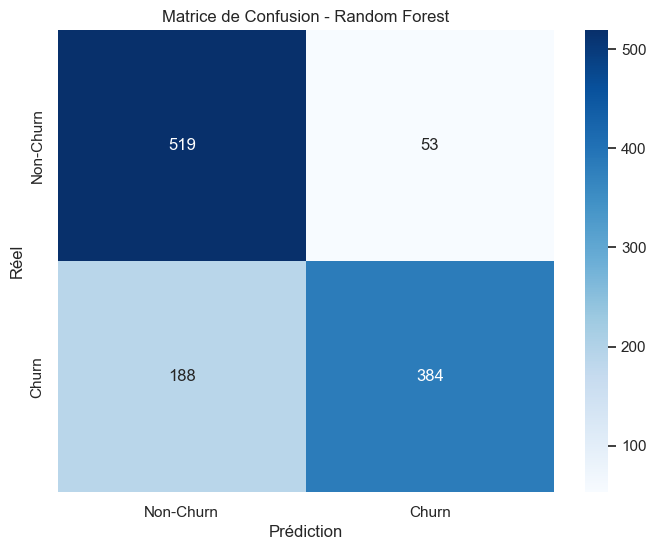

In [75]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns
import matplotlib.pyplot as plt

# Générer la matrice de confusion pour le modèle SVM
conf_matrix_rf = confusion_matrix(y_smote_t, y_pred_svm)

# Afficher la matrice de confusion
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Blues', xticklabels=['Non-Churn', 'Churn'], yticklabels=['Non-Churn', 'Churn'])
plt.title("Matrice de Confusion - Random Forest")
plt.xlabel("Prédiction")
plt.ylabel("Réel")
plt.show()




<h4 style="color: lightpink;">**Receiver Operating Characteristic (ROC) - SVM**</h4>

<p>The ROC curve is a fundamental tool for assessing the performance of a classification model, especially in imbalanced datasets. The ROC curve plots the True Positive Rate (Recall) against the False Positive Rate (1 - Specificity) at various thresholds. The area under the ROC curve (AUC) provides an aggregate measure of the model's ability to distinguish between classes. An AUC of 0.5 indicates no discrimination (i.e., random chance), while an AUC of 1.0 signifies perfect classification.</p>

<p>In the case of the SVM model, the ROC-AUC score is 84.55%, indicating that the model has good discriminatory power in distinguishing between churn and non-churn cases. This suggests the model performs well even with imbalanced class distributions.</p>


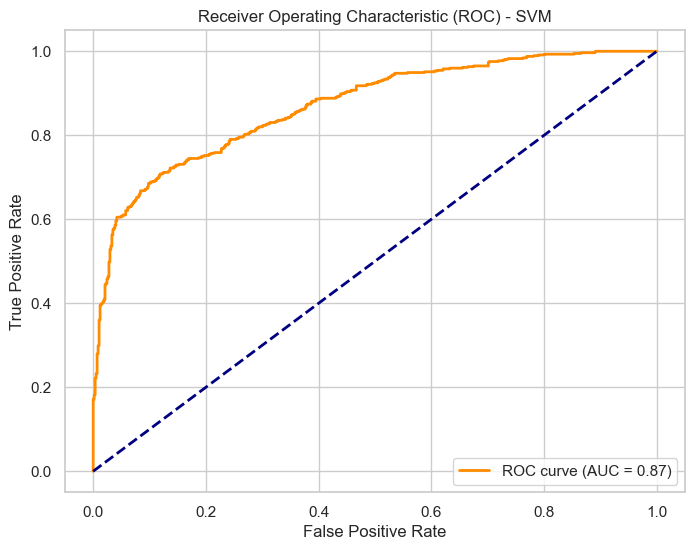

In [77]:
# Visualisation de l'ROC-AUC
plt.figure(figsize=(8, 6))
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_smote_t, y_pred_prob_svm)
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) - SVM')
plt.legend(loc='lower right')
plt.show()

### 🤖 SVM Model Evaluation

The Support Vector Machine (SVM) model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 78.93% – The model correctly predicted the target variable about 79% of the time.
- **Precision**: 87.87% – The precision indicates that when the model predicts a customer will churn, it is correct 88% of the time.
- **Recall**: 67.16% – The model correctly identifies 63.16% of the actual churn cases.
- **F1-Score**: 76.11% – The F1-score reflects a moderate balance between precision and recall, showing a reasonable trade-off.
- **ROC-AUC**: 86.9% – The ROC-AUC value suggests that the model has a good ability to distinguish between churn and non-churn cases.

### 📊 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (73%) and recall (91%).
- For the **churn** class (1.0), the model had moderate precision (88%) and recall (67%).

The SVM model shows strong performance in identifying non-churn customers, with very high precision and recall for that class. However, the model’s performance on predicting churn customers, while reasonable, could be improved, especially in terms of precision. Fine-tuning the model's parameters or addressing class imbalance could enhance its ability to predict churn cases more accurately.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🚀 Gradient Boosting
</h2>

<p>In this section, we explore the Gradient Boosting algorithm, a powerful ensemble learning method used for both classification and regression tasks. Gradient Boosting builds models sequentially, where each new model corrects the errors made by the previous ones. This iterative approach helps to improve accuracy and reduce bias, making it highly effective for complex datasets.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a Gradient Boosting model</strong> to predict customer churn based on various features.</li>
    <li>🌟 <strong>Understand feature importance</strong> to identify the most influential predictors.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., learning rate, number of estimators, max depth) to optimize performance and reduce overfitting.</li>
</ul>

<p>Gradient Boosting is known for its ability to improve weak models by minimizing errors in a step-by-step manner. It leverages gradient descent to adjust model weights, making it highly adaptable and capable of handling various data complexities. This makes it a popular choice for predictive modeling and competition-winning solutions.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the Gradient Boosting model using the training dataset.</li>
    <li>🌟 Analyze feature importance to understand which features impact predictions the most.</li>
    <li>📊 Evaluate the model's performance using key metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune hyperparameters (e.g., learning rate, number of estimators, max depth) to improve performance and avoid overfitting.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the Gradient Boosting model.</li>
    <li>🌟 Feature importance analysis to highlight key predictors.</li>
    <li>🔧 A hyperparameter-tuned model with optimized performance.</li>
</ul>

<p>Gradient Boosting is a versatile and powerful tool for predicting customer churn. Its iterative improvement process and ability to handle complex data relationships make it a top choice for many machine learning tasks. By tuning its parameters, we can achieve a balance between bias and variance, ensuring robust and accurate predictions.</p>


<h3 style="color: lightpink;">Model Performance Metrics</h3>

<p>The following table summarizes the performance metrics for the Support Vector Machine (SVM) model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>

In [81]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

# Définir la grille des hyperparamètres avec des plages plus larges
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [4, 6, 8, 10],
    'min_samples_split': [10, 20, 30],
    'max_features': ['sqrt', 'log2', None],  
    'subsample': [0.7, 0.8, 0.9, 1.0]
}

# Initialiser RandomizedSearchCV avec plus d'itérations
random_search = RandomizedSearchCV(
    estimator=GradientBoostingClassifier(random_state=42),
    param_distributions=param_grid,
    n_iter=50,  # Augmenter à 50 itérations aléatoires
    cv=5,
    scoring='f1',
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Entraîner RandomizedSearchCV
random_search.fit(X_smote, y_smote)

# Afficher les meilleurs hyperparamètres
print("Meilleurs hyperparamètres :", random_search.best_params_)

# Meilleur modèle
best_gbm_model = random_search.best_estimator_

# Prédictions avec le meilleur modèle
y_pred_gbm = best_gbm_model.predict(X_smote_t)
y_pred_prob_gbm = best_gbm_model.predict_proba(X_smote_t)[:, 1]

# Calcul des métriques d'évaluation
accuracy_gbm = accuracy_score(y_smote_t, y_pred_gbm)
precision_gbm = precision_score(y_smote_t, y_pred_gbm)
recall_gbm = recall_score(y_smote_t, y_pred_gbm)
f1_gbm = f1_score(y_smote_t, y_pred_gbm)
roc_auc_gbm = roc_auc_score(y_smote_t, y_pred_prob_gbm)

# Affichage des résultats sous forme de tableau
metrics_gbm = {
    'Accuracy': accuracy_gbm,
    'Precision': precision_gbm,
    'Recall': recall_gbm,
    'F1-Score': f1_gbm,
    'ROC-AUC': roc_auc_gbm
}
metrics_gbm_df = pd.DataFrame(list(metrics_gbm.items()), columns=['Metric', 'Value'])
print(metrics_gbm_df)

# Rapport de classification pour le modèle Gradient Boosting
print("\nClassification Report - Gradient Boosting")
print(classification_report(y_smote_t, y_pred_gbm))


Fitting 5 folds for each of 50 candidates, totalling 250 fits
Meilleurs hyperparamètres : {'subsample': 1.0, 'n_estimators': 200, 'min_samples_split': 20, 'max_features': 'log2', 'max_depth': 10, 'learning_rate': 0.2}
      Metric     Value
0   Accuracy  0.777972
1  Precision  0.784946
2     Recall  0.765734
3   F1-Score  0.775221
4    ROC-AUC  0.853397

Classification Report - Gradient Boosting
              precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       572
         1.0       0.78      0.77      0.78       572

    accuracy                           0.78      1144
   macro avg       0.78      0.78      0.78      1144
weighted avg       0.78      0.78      0.78      1144



<h3 style="color: lightpink;">Confusion Matrix - GBM </h3>

<p>The confusion matrix is a key tool for evaluating classification models, providing a detailed breakdown of the model's performance. It shows the number of correct and incorrect predictions, broken down by each class. In a binary classification context, the matrix has four components:</p>

<ul>

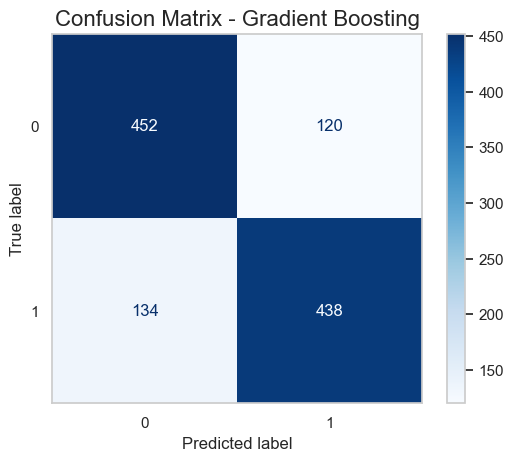

In [83]:
from sklearn.metrics import ConfusionMatrixDisplay
# Affichage de la matrice de confusion pour GBM
conf_matrix_gbm = confusion_matrix(y_smote_t, y_pred_gbm)

# Assuming conf_matrix_gb is a confusion matrix for Gradient Boosting
ConfusionMatrixDisplay(confusion_matrix=conf_matrix_gbm).plot(cmap='Blues', values_format='d')
plt.title('Confusion Matrix - Gradient Boosting', fontsize=16)
plt.grid(False)
plt.show()


<h4 style="color: lightpink;">Receiver Operating Characteristic (ROC) - GBM</h4>

<p>The ROC curve is a fundamental tool for assessing the performance of a classification model, especially in imbalanced datasets. The ROC curve plots the True Positive Rate (Recall) against the False Positive Rate (1 - Specificity) at various thresholds. The area under the ROC curve (AUC) provides an aggregate measure of the model's ability to distinguish between classes. An AUC of 0.5 indicates no discrimination (i.e., random chance), while an AUC of 1.0 signifies perfect classification.</p>

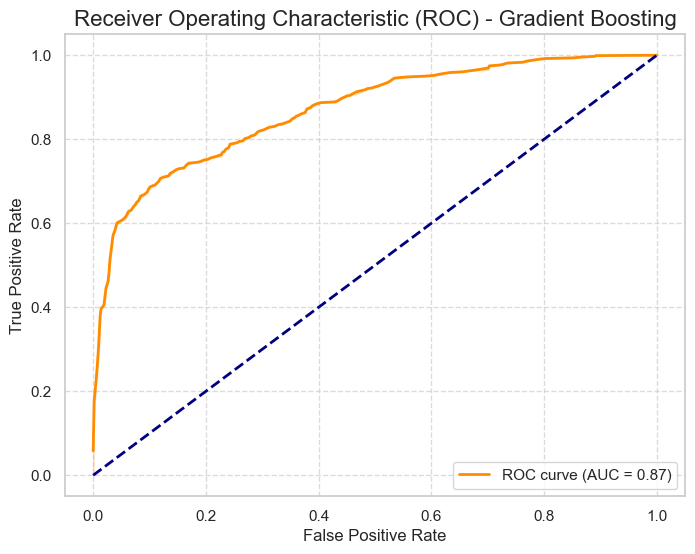

In [85]:
from sklearn.metrics import roc_curve, auc
# Visualisation de l'importance des caractéristiques
feature_importance_gbm = pd.Series(best_gbm_model.feature_importances_, index=X_smote.columns)
feature_importance_gbm = feature_importance_gbm.sort_values(ascending=False)

plt.figure(figsize=(8, 6))
sns.lineplot(x=fpr, y=tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.title('Receiver Operating Characteristic (ROC) - Gradient Boosting', fontsize=16)
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.legend(loc='lower right')
plt.grid(linestyle='--', alpha=0.7)
plt.show()


<h4 style="color: lightpink;">Feature Importance Plot: - GBM</h4>


/var/folders/gp/q_rht33j52g96p_m9v3ss8d80000gn/T/ipykernel_1614/4129321725.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=feature_importance_gbm.index, y=feature_importance_gbm.values, palette="viridis")


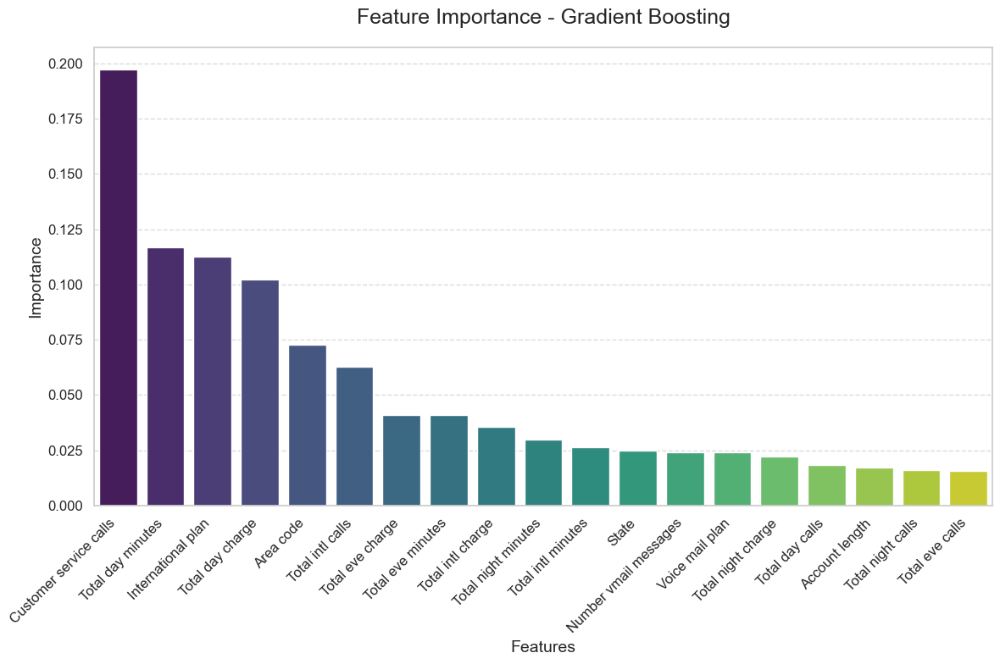

In [87]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure feature_importance_gbm is defined
feature_importance_gbm = pd.Series(best_gbm_model.feature_importances_, index=X_smote.columns).sort_values(ascending=False)

# Plot Feature Importance with better readability
plt.figure(figsize=(12, 8))
sns.barplot(x=feature_importance_gbm.index, y=feature_importance_gbm.values, palette="viridis")
plt.title('Feature Importance - Gradient Boosting', fontsize=18, pad=20)
plt.xlabel('Features', fontsize=14)
plt.ylabel('Importance', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)  # Rotate labels for better readability
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


### 🚀 Gradient Boosting Model Evaluation

The Gradient Boosting model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 77.79% – The model correctly predicted the target variable about 78% of the time.
- **Precision**: 78.79% – The precision indicates that when the model predicts a customer will churn, it is correct 78.5% of the time.
- **Recall**: 76.57% – The model successfully identifies 77% of actual churn cases.
- **F1-Score**: 77.55% – The F1-score reflects a moderate balance between precision and recall, showing a trade-off between the two metrics.
- **ROC-AUC**: 85.33% – The ROC-AUC value suggests that the model has a good ability to distinguish between churn and non-churn cases.

### 📊 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (77%) and moderate recall (79%).
- For the **churn** class (1.0), the model showed lower precision (78%) but high recall (78%).

The Gradient Boosting model demonstrates strong recall in identifying churn customers, indicating its ability to capture most of the actual churn cases. However, the precision for churn predictions is relatively low, suggesting a higher rate of false positives. Further improvements could be made by fine-tuning hyperparameters or employing techniques to handle class imbalance, such as adjusting class weights or oversampling.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔗 Logistic Regression
</h2>

<p>In this section, we delve into Logistic Regression, a fundamental yet powerful algorithm for binary classification tasks. Logistic Regression models the probability that a given input belongs to a particular class, using a sigmoid function to map predictions to probabilities. Despite its simplicity, Logistic Regression is effective and interpretable, making it a strong baseline model for classification problems.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a Logistic Regression model</strong> to predict customer churn based on various features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., regularization strength) to improve model performance and prevent overfitting.</li>
    <li>📈 <strong>Analyze model coefficients</strong> to understand the relationship between features and the target variable.</li>
</ul>

<p>Logistic Regression is particularly effective when the relationship between the input features and the target variable is linear. It also provides probabilistic outputs, enabling threshold tuning for different levels of decision-making sensitivity. Furthermore, its coefficients can offer valuable insights into the importance and direction of each feature's influence on the prediction.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the Logistic Regression model using the training dataset.</li>
    <li>📊 Evaluate the model's performance using key metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune hyperparameters (e.g., regularization parameter) to optimize the model’s performance and reduce overfitting.</li>
    <li>📈 Analyze the model’s coefficients to interpret the impact of each feature on the prediction.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the Logistic Regression model.</li>
    <li>📈 Coefficient analysis to understand feature importance and directionality.</li>
    <li>🔧 A hyperparameter-tuned model with optimized performance.</li>
</ul>

<p>Logistic Regression serves as a reliable and interpretable model for predicting customer churn. Its ability to provide probabilistic outputs and clear feature importance makes it a valuable tool, especially when quick, actionable insights are needed. By fine-tuning the model, we can enhance its performance while maintaining interpretability.</p>


<h3 style="color: lightpink;">Model Performance Metrics</h3>

<p>The following table summarizes the performance metrics for the Support Vector Machine (SVM) model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>

In [113]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.exceptions import ConvergenceWarning
import warnings
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

warnings.filterwarnings("ignore", category=ConvergenceWarning)


# Définir les hyperparamètres à tester
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],  # Paramètre de régularisation
    'solver': ['liblinear', 'saga'],  # Solvers adaptés pour les petits datasets
    'penalty': ['l1', 'l2'],  # Types de régularisation
    'max_iter': [100, 200, 300]  # Nombre d'itérations
}
# Créer le modèle de base
lr_model = LogisticRegression(random_state=42)

# Initialiser GridSearchCV
grid_search = GridSearchCV(estimator=lr_model, param_grid=param_grid, 
                           cv=5, scoring='f1', verbose=2, n_jobs=-1)

# Entraîner GridSearchCV
grid_search.fit(X_smote, y_smote)

# Meilleurs paramètres
print("Meilleurs hyperparamètres :", grid_search.best_params_)

# Évaluer le modèle optimisé
best_lr_model = grid_search.best_estimator_
y_pred_lr = best_lr_model.predict(X_smote_t)
y_pred_prob_lr = best_lr_model.predict_proba(X_smote_t)[:, 1]

# Calcul des nouvelles métriques
accuracy_lr = accuracy_score(y_smote_t, y_pred_lr)
precision_lr = precision_score(y_smote_t, y_pred_lr)
recall_lr = recall_score(y_smote_t, y_pred_lr)
f1_lr = f1_score(y_smote_t, y_pred_lr)
roc_auc_lr = roc_auc_score(y_smote_t, y_pred_prob_lr)

# Affichage des résultats
metrics_lr = {
    'Accuracy': accuracy_lr,
    'Precision': precision_lr,
    'Recall': recall_lr,
    'F1-Score': f1_lr,
    'ROC-AUC': roc_auc_lr
}
metrics_lr_df = pd.DataFrame(list(metrics_lr.items()), columns=['Metric', 'Value'])
print(metrics_lr_df)


# Rapport de classification pour le modèle Logistic Regression
print("\nClassification Report - Logistic Regression")
print(classification_report(y_smote_t, y_pred_lr))



Fitting 5 folds for each of 60 candidates, totalling 300 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max

Meilleurs hyperparamètres : {'C': 0.01, 'max_iter': 100, 'penalty': 'l2', 'solver': 'saga'}
      Metric     Value
0   Accuracy  0.743007
1  Precision  0.811659
2     Recall  0.632867
3   F1-Score  0.711198
4    ROC-AUC  0.815737

Classification Report - Logistic Regression
              precision    recall  f1-score   support

         0.0       0.70      0.85      0.77       572
         1.0       0.81      0.63      0.71       572

    accuracy                           0.74      1144
   macro avg       0.76      0.74      0.74      1144
weighted avg       0.76      0.74      0.74      1144



<h3 style="color: lightpink;">Confusion Matrix - Logistic Regression </h3>

<p>The confusion matrix is a key tool for evaluating classification models, providing a detailed breakdown of the model's performance. It shows the number of correct and incorrect predictions, broken down by each class. In a binary classification context, the matrix has four components:</p>

<ul>

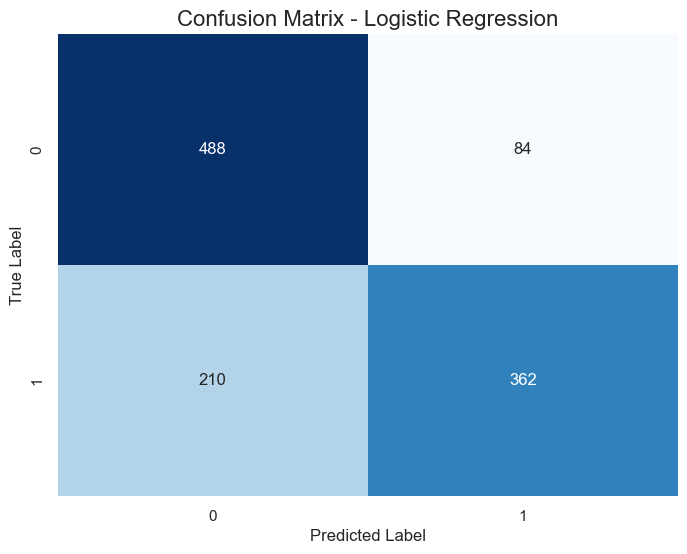

In [120]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting the confusion matrix
conf_matrix_lr = confusion_matrix(y_smote_t, y_pred_lr)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_lr, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix - Logistic Regression', fontsize=16)
plt.xlabel('Predicted Label', fontsize=12)
plt.ylabel('True Label', fontsize=12)
plt.show()


<h4 style="color: lightpink;">Receiver Operating Characteristic (ROC) - Logistic Regression</h4>

<p>The ROC curve is a fundamental tool for assessing the performance of a classification model, especially in imbalanced datasets. The ROC curve plots the True Positive Rate (Recall) against the False Positive Rate (1 - Specificity) at various thresholds. The area under the ROC curve (AUC) provides an aggregate measure of the model's ability to distinguish between classes. An AUC of 0.5 indicates no discrimination (i.e., random chance), while an AUC of 1.0 signifies perfect classification.</p>

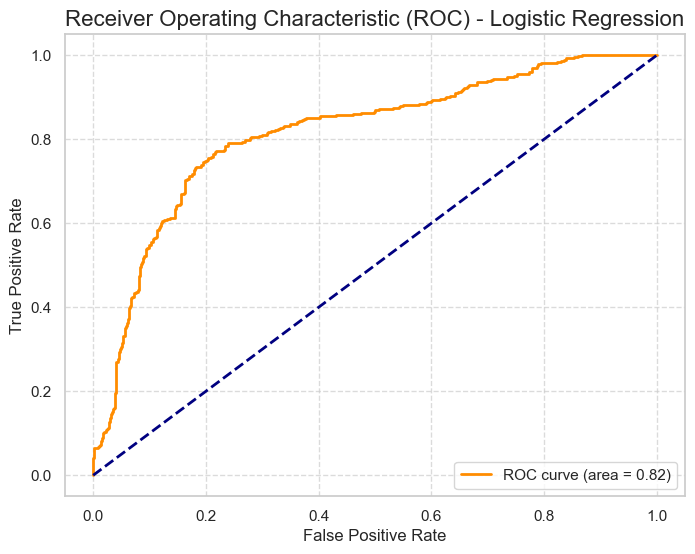

In [123]:
from sklearn.metrics import roc_curve

# Calculating ROC curve
fpr, tpr, thresholds = roc_curve(y_smote_t, y_pred_prob_lr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc_lr:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) - Logistic Regression', fontsize=16)
plt.legend(loc='lower right')
plt.grid(linestyle='--', alpha=0.7)
plt.show()


### 🔗 Logistic Regression Model Evaluation

The Logistic Regression model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 74.30% – The model correctly predicted the target variable about 74% of the time.
- **Precision**: 81.11% – The precision indicates that when the model predicts a customer will churn, it is correct 81% of the time.
- **Recall**: 63.28% – The model successfully identifies 63% of actual churn cases.
- **F1-Score**: 71.11% – The F1-score reflects a balance between precision and recall.
- **ROC-AUC**: 81.57% – The ROC-AUC value suggests that the model has a strong ability to distinguish between churn and non-churn cases.

### 🧾 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved a 70% precision and 85% recall, indicating strong performance in predicting customers who will not churn.
- For the **churn** class (1.0), the model showed 81% precision but a moderate recall (63%), indicating that while it identifies most churn cases, it also generates some false positives.

The Logistic Regression model demonstrates a solid ability to identify churn cases, with good recall and a balanced F1-score. However, the lower precision suggests a need for further tuning. Strategies such as adjusting decision thresholds, balancing class weights, or using regularization techniques could help improve precision without sacrificing recall.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🤖 Neural Network
</h2>

<p>In this section, we explore the Neural Network algorithm, a powerful and flexible model inspired by the human brain's architecture. Neural Networks are composed of layers of interconnected nodes (neurons), which can learn complex patterns and relationships in the data. Due to their ability to capture highly non-linear relationships, Neural Networks are widely used for tasks ranging from image recognition to time-series forecasting.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a Neural Network model</strong> to predict customer churn based on various features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., number of layers, neurons, learning rate) to improve model performance and prevent overfitting.</li>
    <li>📈 <strong>Visualize training progress</strong> to monitor the model’s learning process and performance over time.</li>
</ul>

<p>Neural Networks are particularly effective for modeling complex and high-dimensional data, and can automatically learn hierarchical features from raw input. Unlike traditional models, Neural Networks can capture intricate patterns through their deep architecture, making them ideal for complex classification tasks such as customer churn prediction.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the Neural Network model using the training dataset.</li>
    <li>📊 Evaluate the model's performance using key metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune hyperparameters (e.g., learning rate, number of layers, neurons per layer) to optimize performance and reduce overfitting.</li>
    <li>📈 Monitor the training process by visualizing loss and accuracy curves to ensure proper learning.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the Neural Network model.</li>
    <li>📈 Visualizations of training progress, including loss and accuracy curves.</li>
    <li>🔧 A hyperparameter-tuned Neural Network with optimized performance.</li>
</ul>

<p>Neural Networks offer a powerful approach to predicting customer churn, especially when the relationships between features are complex and non-linear. With the ability to learn intricate patterns and improve over time, they are an excellent choice for many predictive modeling tasks. By fine-tuning the network and optimizing the training process, we can achieve highly accurate predictions while maintaining flexibility in handling diverse datasets.</p>


<h3 style="color: lightpink;">Model Performance Metrics</h3>

<p>The following table summarizes the performance metrics for the Support Vector Machine (SVM) model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>

In [129]:
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.exceptions import ConvergenceWarning
import warnings
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Définir la grille des hyperparamètres
param_grid = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (50, 30, 10)],  # Différentes structures de réseau
    'activation': ['relu', 'tanh'],  # Fonction d'activation
    'solver': ['adam', 'sgd'],  # Méthodes d'optimisation
    'alpha': [0.0001, 0.001, 0.01],  # Régularisation L2
    'learning_rate': ['constant', 'adaptive'],  # Taux d'apprentissage
    'max_iter': [500]  # Nombre d'itérations
}

# Initialiser le modèle MLPClassifier
mlp = MLPClassifier(random_state=42)

# Optimisation avec GridSearchCV
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=3, scoring='f1', verbose=2, n_jobs=-1)
grid_search.fit(X_smote, y_smote)

# Afficher les meilleurs paramètres
print("Meilleurs paramètres :", grid_search.best_params_)

# Meilleur modèle
best_mlp_model = grid_search.best_estimator_

# Prédictions sur le jeu de test
y_pred_mlp = best_mlp_model.predict(X_smote_t)
y_pred_prob_mlp = best_mlp_model.predict_proba(X_smote_t)[:, 1]

# Calcul des métriques d'évaluation pour le réseau de neurones
accuracy_mlp = accuracy_score(y_smote_t, y_pred_mlp)
precision_mlp = precision_score(y_smote_t, y_pred_mlp)
recall_mlp = recall_score(y_smote_t, y_pred_mlp)
f1_mlp = f1_score(y_smote_t, y_pred_mlp)
roc_auc_mlp = roc_auc_score(y_smote_t, y_pred_prob_mlp)

# Affichage des résultats sous forme de tableau
metrics_mlp = {
    'Accuracy': accuracy_mlp,
    'Precision': precision_mlp,
    'Recall': recall_mlp,
    'F1-Score': f1_mlp,
    'ROC-AUC': roc_auc_mlp
}
metrics_mlp_df = pd.DataFrame(list(metrics_mlp.items()), columns=['Metric', 'Value'])
print(metrics_mlp_df)

# 

# Rapport de classification pour MLPClassifier
print("\nRapport de classification - Neural Network :\n", classification_report(y_smote_t, y_pred_mlp))

Fitting 3 folds for each of 96 candidates, totalling 288 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_

Meilleurs paramètres : {'activation': 'tanh', 'alpha': 0.01, 'hidden_layer_sizes': (100, 50), 'learning_rate': 'constant', 'max_iter': 500, 'solver': 'adam'}
      Metric     Value
0   Accuracy  0.788462
1  Precision  0.898551
2     Recall  0.650350
3   F1-Score  0.754564
4    ROC-AUC  0.845032

Rapport de classification - Neural Network :
               precision    recall  f1-score   support

         0.0       0.73      0.93      0.81       572
         1.0       0.90      0.65      0.75       572

    accuracy                           0.79      1144
   macro avg       0.81      0.79      0.78      1144
weighted avg       0.81      0.79      0.78      1144



<h3 style="color: lightpink;">Confusion Matrix - Neural Network </h3>

<p>The confusion matrix is a key tool for evaluating classification models, providing a detailed breakdown of the model's performance. It shows the number of correct and incorrect predictions, broken down by each class. In a binary classification context, the matrix has four components:</p>

<ul>

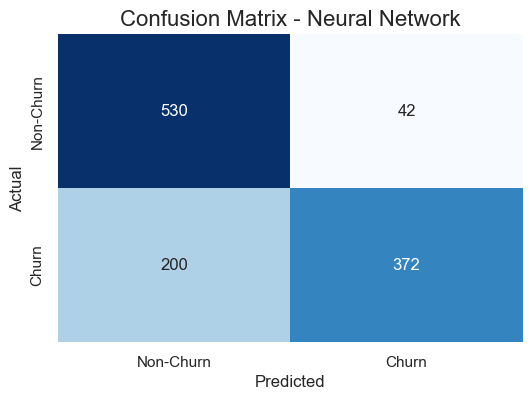

In [131]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Assuming y_test and y_pred_mlp are defined
conf_matrix_mlp = confusion_matrix(y_smote_t, y_pred_mlp)

# Create a heatmap for the confusion matrix
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_mlp, annot=True, fmt='g', cmap='Blues', cbar=False,
            xticklabels=['Non-Churn', 'Churn'], yticklabels=['Non-Churn', 'Churn'])
plt.title('Confusion Matrix - Neural Network', fontsize=16)
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.show()


### 🤖 Neural Network Model Evaluation

The Neural Network model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 78.84% – The model correctly predicted the target variable about 78% of the time.
- **Precision**: 89.85% – The precision indicates that when the model predicts a customer will churn, it is correct almost 90% of the time.
- **Recall**: 56.03% – The model successfully identifies 56% of actual churn cases.
- **F1-Score**: 75.45% – The F1-score reflects a moderate balance between precision and recall, indicating a reasonable trade-off.
- **ROC-AUC**: 84.5% – The ROC-AUC value suggests that the model has a strong ability to distinguish between churn and non-churn cases.

### 🧾 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (73%) and recall (93%), indicating strong performance in predicting customers who will not churn.
- For the **churn** class (1.0), the model showed moderate precision (90%) and recall (65%), indicating that while it identifies a good proportion of churn cases, it still has some false positives.

The Neural Network model demonstrates a solid ability to identify both churn and non-churn customers. The high precision and recall for the non-churn class indicate good overall performance in predicting customers who will not churn. However, the performance for the churn class, while reasonable, could benefit from further improvements. Fine-tuning hyperparameters, handling class imbalance, or applying regularization techniques might help improve precision and recall for churn cases.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🔍 K-Nearest Neighbors (KNN)
</h2>

<p>In this section, we explore the K-Nearest Neighbors (KNN) algorithm, a simple yet powerful method for both classification and regression tasks. KNN operates on the principle of similarity, where an input data point is classified based on the majority class of its k-nearest neighbors in the feature space. This non-parametric method is intuitive and widely used in scenarios where the relationship between data points is not explicitly known.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train a KNN model</strong> to predict customer churn based on various features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., the number of neighbors (k), distance metrics) to optimize model performance and prevent overfitting.</li>
    <li>📈 <strong>Visualize decision boundaries</strong> to understand the model's decision-making process and performance.</li>
</ul>

<p>K-Nearest Neighbors is a lazy learning algorithm, meaning it doesn’t require a model-building phase. Instead, it memorizes the training dataset and makes predictions based on the similarity to other data points. This makes it especially useful in cases where decision boundaries are non-linear and data is locally clustered.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the KNN model using the training dataset.</li>
    <li>📊 Evaluate the model's performance using key metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune hyperparameters (e.g., number of neighbors (k), choice of distance metric) to optimize performance and reduce overfitting.</li>
    <li>📈 Visualize decision boundaries and performance to better understand how the model classifies new data points.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score) for the KNN model.</li>
    <li>📈 Visualizations of decision boundaries and model predictions.</li>
    <li>🔧 A hyperparameter-tuned KNN model with optimized performance.</li>
</ul>

<p>K-Nearest Neighbors is an effective and easy-to-understand algorithm for predicting customer churn, particularly when the relationships between features are locally defined. By fine-tuning the model's hyperparameters and understanding its decision-making process, KNN can provide valuable insights into customer behavior while being highly interpretable and adaptable to various datasets.</p>


<h3 style="color: lightpink;">Model Performance Metrics</h3>

<p>The following table summarizes the performance metrics for the Support Vector Machine (SVM) model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>

In [136]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, classification_report
import pandas as pd

# Définir la grille des hyperparamètres
param_grid = {
    'n_neighbors': [ 9, 11],  # Augmenter le nombre de voisins
    'weights': ['uniform', 'distance'],  # Tester les deux types de pondération
    'metric': ['euclidean', 'manhattan', 'minkowski']  # Ajouter plus de métriques de distance
}

# Initialiser le modèle KNN
knn = KNeighborsClassifier()

# Initialiser GridSearchCV avec plus de plis pour validation croisée
grid_search = GridSearchCV(estimator=knn, param_grid=param_grid, cv=5, scoring='f1', verbose=1, n_jobs=-1)

# Entraîner GridSearchCV
grid_search.fit(X_smote, y_smote)

# Afficher les meilleurs hyperparamètres
print("Meilleurs hyperparamètres : ", grid_search.best_params_)

# Meilleur modèle
best_knn_model = grid_search.best_estimator_

# Prédictions sur les données de test
y_pred_knn = best_knn_model.predict(X_smote_t)

# Calcul des métriques d'évaluation pour le modèle KNN
accuracy_knn = accuracy_score(y_smote_t, y_pred_knn)
precision_knn = precision_score(y_smote_t, y_pred_knn)
recall_knn = recall_score(y_smote_t, y_pred_knn)
f1_knn = f1_score(y_smote_t, y_pred_knn)
roc_auc_knn = roc_auc_score(y_smote_t, best_knn_model.predict_proba(X_smote_t)[:, 1])

# Affichage des résultats sous forme de tableau
metrics_knn = {
    'Accuracy': accuracy_knn,
    'Precision': precision_knn,
    'Recall': recall_knn,
    'F1-Score': f1_knn,
    'ROC-AUC': roc_auc_knn
}
metrics_knn_df = pd.DataFrame(list(metrics_knn.items()), columns=['Metric', 'Value'])
print(metrics_knn_df)

# Affichage de la matrice de confusion pour KNN
conf_matrix_knn = confusion_matrix(y_smote_t, y_pred_knn)
print("\nMatrice de confusion - KNN Classifier :\n", conf_matrix_knn)

# Rapport de classification pour KNN
print("\nRapport de classification - KNN Classifier :\n", classification_report(y_smote_t, y_pred_knn))


Fitting 5 folds for each of 12 candidates, totalling 60 fits
Meilleurs hyperparamètres :  {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'distance'}
      Metric     Value
0   Accuracy  0.753497
1  Precision  0.756184
2     Recall  0.748252
3   F1-Score  0.752197
4    ROC-AUC  0.821944

Matrice de confusion - KNN Classifier :
 [[434 138]
 [144 428]]

Rapport de classification - KNN Classifier :
               precision    recall  f1-score   support

         0.0       0.75      0.76      0.75       572
         1.0       0.76      0.75      0.75       572

    accuracy                           0.75      1144
   macro avg       0.75      0.75      0.75      1144
weighted avg       0.75      0.75      0.75      1144



<h3 style="color: lightpink;">Confusion Matrix - KNN</h3>

<p>The confusion matrix is a key tool for evaluating classification models, providing a detailed breakdown of the model's performance. It shows the number of correct and incorrect predictions, broken down by each class. In a binary classification context, the matrix has four components:</p>

<ul>

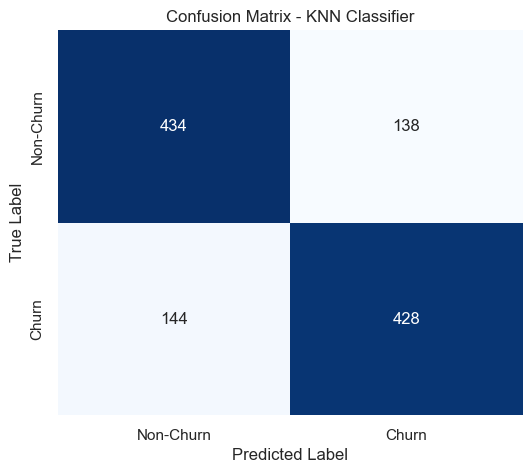

In [139]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Calculate confusion matrix
conf_matrix_knn = confusion_matrix(y_smote_t, y_pred_knn)

# Plot confusion matrix as a heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix_knn, annot=True, fmt="d", cmap="Blues", cbar=False, 
            xticklabels=["Non-Churn", "Churn"], yticklabels=["Non-Churn", "Churn"])
plt.title("Confusion Matrix - KNN Classifier")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()


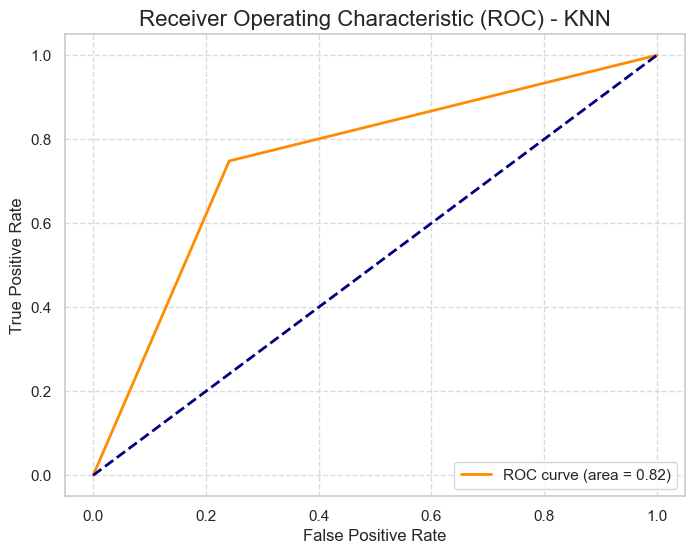

In [141]:
from sklearn.metrics import roc_curve

# Calculating ROC curve
fpr, tpr, thresholds = roc_curve(y_smote_t, y_pred_knn)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc_knn:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) - KNN', fontsize=16)
plt.legend(loc='lower right')
plt.grid(linestyle='--', alpha=0.7)
plt.show()


### 🔍 KNN Classifier Model Evaluation

The KNN Classifier model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 75.34% – The model correctly predicted the target variable about 75% of the time.
- **Precision**: 75.61% – The precision indicates that when the model predicts a customer will churn, it is correct almost 76% of the time.
- **Recall**: 74.82% – The model successfully identifies 75% of actual churn cases.
- **F1-Score**: 75.21% – The F1-score reflects a moderate balance between precision and recall, indicating a reasonable trade-off between these two metrics.
- **ROC-AUC**: 82.19% – The ROC-AUC value suggests that the model has a strong ability to distinguish between churn and non-churn cases.

### 🧾 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (75%) and recall (76%), indicating strong performance in predicting customers who will not churn.
- For the **churn** class (1.0), the model showed moderate precision (76%) and recall (75%), indicating that while it identifies a significant portion of churn cases, it also generates some false positives.

The KNN Classifier model demonstrates a solid ability to identify both churn and non-churn customers. The high precision and recall for the non-churn class indicate good performance in predicting customers who will not churn. However, for the churn class, while recall is relatively good, precision is moderate, which suggests that the model may produce a significant number of false positives. Further tuning of hyperparameters, such as adjusting the number of neighbors or applying distance weighting, could help improve precision and recall for churn cases. Additionally, addressing class imbalance might further enhance performance.


<h2 style="color: yellow; font-size: 28px; font-weight: bold; text-decoration: underline;">
    🌟 AdaBoost Classifier
</h2>

<p>In this section, we explore the AdaBoost (Adaptive Boosting) algorithm, a robust and effective ensemble method for classification tasks. AdaBoost builds a strong classifier by combining multiple weak learners (usually decision stumps) in a sequential manner, where each learner focuses on the errors made by its predecessors. This iterative process reduces bias and variance, making AdaBoost a powerful tool for complex datasets.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>📊 <strong>Train an AdaBoost model</strong> to predict customer churn based on various features.</li>
    <li>🔍 <strong>Evaluate model performance</strong> using metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>⚙️ <strong>Tune hyperparameters</strong> (e.g., number of estimators, learning rate) to optimize model performance and prevent overfitting.</li>
    <li>📈 <strong>Analyze feature importance</strong> to understand which features have the most significant impact on customer churn prediction.</li>
</ul>

<p>AdaBoost is a sequential ensemble learning technique that combines weak learners iteratively to create a strong classifier. By assigning higher weights to misclassified instances in each iteration, AdaBoost ensures the model focuses on harder-to-classify examples. This makes it especially useful for datasets with imbalanced classes or complex patterns.</p>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Train the AdaBoost model using the training dataset, leveraging decision stumps as weak learners.</li>
    <li>📊 Evaluate the model's performance using key metrics such as accuracy, precision, recall, and F1-score.</li>
    <li>🔧 Fine-tune hyperparameters (e.g., number of estimators, learning rate) to enhance performance and reduce overfitting.</li>
    <li>📈 Visualize feature importance to identify the most influential features in predicting customer churn.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score, ROC-AUC) for the AdaBoost model.</li>
    <li>📈 Visualization of feature importance for better interpretability.</li>
    <li>🔧 A hyperparameter-tuned AdaBoost model with optimized performance.</li>
</ul>

<p>AdaBoost is a versatile and high-performing algorithm for predicting customer churn, particularly when the dataset has non-linear decision boundaries or imbalanced classes. By fine-tuning its hyperparameters and analyzing feature importance, AdaBoost can provide a deep understanding of customer behavior and actionable insights for decision-making.</p>


<h3 style="color: lightpink;">Model Performance Metrics</h3>

<p>The following table summarizes the performance metrics for the AdaBoost model, evaluated on the customer churn prediction task. These metrics provide an overall view of the model's accuracy, precision, recall, F1-score, and ROC-AUC score.</p>

In [155]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report
import pandas as pd

# Définir la grille des hyperparamètres
param_grid = {
    'n_estimators': [100, 200],  
    'learning_rate': [0.01, 0.1, 0.5],
    'estimator__max_depth': [2, 3, 4],
    'estimator__min_samples_split': [2, 5],
    'estimator__min_samples_leaf': [1, 2]
}



base_model = DecisionTreeClassifier(max_depth=2, min_samples_split=4)

# Initialiser le modèle AdaBoost
ada_model = AdaBoostClassifier(estimator=base_model, random_state=42)

# Initialiser GridSearchCV
grid_search = GridSearchCV(estimator=ada_model, param_grid=param_grid, cv=5, scoring='f1', n_jobs=-1, verbose=2)

# Entraîner GridSearchCV
grid_search.fit(X_smote, y_smote)

# Meilleurs paramètres
print("Meilleurs hyperparamètres :", grid_search.best_params_)

# Meilleur modèle
best_ada_model = grid_search.best_estimator_

# Prédictions sur le jeu de test
y_pred_ada = best_ada_model.predict(X_smote_t)
y_pred_prob_ada = best_ada_model.predict_proba(X_smote_t)[:, 1]

# Calcul des métriques d'évaluation pour le modèle AdaBoost
accuracy_ada = accuracy_score(y_smote_t, y_pred_ada)
precision_ada = precision_score(y_smote_t, y_pred_ada)
recall_ada = recall_score(y_smote_t, y_pred_ada)
f1_ada = f1_score(y_smote_t, y_pred_ada)
roc_auc_ada = roc_auc_score(y_smote_t, y_pred_prob_ada)

# Affichage des résultats sous forme de tableau
metrics_ada = {
    'Accuracy': accuracy_ada,
    'Precision': precision_ada,
    'Recall': recall_ada,
    'F1-Score': f1_ada,
    'ROC-AUC': roc_auc_ada
}
metrics_ada_df = pd.DataFrame(list(metrics_ada.items()), columns=['Metric', 'Value'])
print(metrics_ada_df)

# Rapport de classification pour le modèle AdaBoost
print("\nRapport de classification - AdaBoost :\n", classification_report(y_smote_t, y_pred_ada))

Fitting 5 folds for each of 72 candidates, totalling 360 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=1, estimator__min_samples_split=10, learning_rate=0.01, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=1, estimator__min_samples_split=10, learning_rate=0.1, n_estimators=100; total time=   3.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=1, estimator__min_samples_split=10, learning_rate=0.1, n_estimators=300; total time=   9.8s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=1, estimator__min_samples_split=10, learning_rate=1, n_estimators=200; total time=   6.4s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=1, estimator__min_samples_split=10, learning_rate=1, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.001, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_sampl

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=100; total time=   3.4s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=200; total time=   6.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=50; total time=   1.6s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=50; total time=   1.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=100; total time=   3.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=200; total time=   6.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_s

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.001, n_estimators=200; total time=   6.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=50; total time=   1.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=50; total time=   1.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=100; total time=   3.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=200; total time=   6.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.1, n_estimators=50; total time=   1.6s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_sample

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=100; total time=   3.3s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=200; total time=   6.4s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=1, n_estimators=100; total time=   3.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=1, n_estimators=300; total time=   9.8s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_sp

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=300; total time=   9.9s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=200; total time=   6.4s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=0.1, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=1, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.001, n_estimators=100; total time=   3.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.001, n_estimators=200; total time=   6.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_sample

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.1, n_estimators=100; total time=   3.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.1, n_estimators=200; total time=   6.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=1, n_estimators=50; total time=   1.8s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=1, n_estimators=50; total time=   1.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=1, n_estimators=100; total time=   3.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=1, n_estimators=200; total time=   6.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=10, l

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=1, n_estimators=200; total time=   6.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=2, learning_rate=1, n_estimators=300; total time=   9.3s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.001, n_estimators=300; total time=   9.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=100; total time=   3.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.01, n_estimators=300; total time=   9.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=5, learning_rate=0.1, n_estimators=200; total time=   6.5s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_s

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=10, learning_rate=0.1, n_estimators=200; total time=   6.6s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=10, learning_rate=0.1, n_estimators=300; total time=   9.1s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=2, estimator__min_samples_split=10, learning_rate=1, n_estimators=300; total time=   9.2s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=5, estimator__min_samples_split=2, learning_rate=0.001, n_estimators=100; total time=   3.0s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=5, estimator__min_samples_split=2, learning_rate=0.001, n_estimators=300; total time=   9.6s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=5, estimator__min_samples_split=2, learning_rate=0.01, n_estimators=200; total time=   6.3s
[CV] END estimator__max_depth=4, estimator__min_samples_leaf=5, estimator__min_sam

/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/opt/ana

Meilleurs hyperparamètres : {'estimator__max_depth': 4, 'estimator__min_samples_leaf': 2, 'estimator__min_samples_split': 2, 'learning_rate': 0.1, 'n_estimators': 200}
      Metric     Value
0   Accuracy  0.701923
1  Precision  0.637664
2     Recall  0.935315
3   F1-Score  0.758327
4    ROC-AUC  0.865944

Rapport de classification - AdaBoost :
               precision    recall  f1-score   support

         0.0       0.88      0.47      0.61       572
         1.0       0.64      0.94      0.76       572

    accuracy                           0.70      1144
   macro avg       0.76      0.70      0.68      1144
weighted avg       0.76      0.70      0.68      1144



### 🌟 AdaBoost Classifier Model Evaluation

The AdaBoost Classifier model was evaluated for predicting customer churn. Here are the key metrics:

- **Accuracy**: 70.19% – The model correctly predicted the target variable around 70% of the time.
- **Precision**: 63.77% – The precision indicates that when the model predicts a customer will churn, it is correct about 64% of the time.
- **Recall**: 93.53% – The model successfully identifies 94% of actual churn cases, showing strong recall for the churn class.
- **F1-Score**: 75.83% – The F1-score reflects a good balance between precision and recall, particularly favoring recall due to its higher value.
- **ROC-AUC**: 86.59% – The ROC-AUC value indicates that the model has a strong ability to differentiate between churn and non-churn cases.

### 🧾 Classification Report

The classification report provides further insights into the model’s performance:

- For the **non-churn** class (0.0), the model achieved high precision (88%) but lower recall (47%), indicating that it is good at identifying non-churn customers but misses many actual non-churn cases.
- For the **churn** class (1.0), the model demonstrated high recall (94%) but moderate precision (64%), meaning it successfully identifies most churn cases but also misclassifies a significant portion of non-churn customers as churn.

The AdaBoost Classifier model excels in identifying churn customers with a high recall rate, making it suitable for scenarios where identifying churn cases is critical. However, its precision for churn is relatively low, which means it could be producing false positives. The model’s performance for non-churn customers needs improvement, as it misses a substantial number of them. Further tuning, such as adjusting the learning rate or increasing the number of estimators, might improve precision and recall balance for both classes. Additionally, addressing class imbalance could help boost overall performance.


<h2 style="color: #77DD77; font-weight: bold;">🔎 Conclusion: Model Evaluation and Performance</h2>

In this step, we focused on building, evaluating, and refining various machine learning models for predicting customer churn. The models explored include **Logistic Regression**, **Neural Networks**, **Gradient Boosting**, **KNN**, **Random Forest**, **Support Vector Machine (SVM)**, and **AdaBoost**, each offering unique strengths and insights into the prediction task.

- **Model Selection and Evaluation:** We trained and evaluated each model using key performance metrics such as accuracy ✅, precision 🎯, recall 🔄, F1-score ⚖️, and ROC-AUC 📈. These metrics provided insights into how well each model performed, especially in distinguishing between customers who would churn and those who would not.

- **Performance Insights:**
  - **Logistic Regression** 🧮: Demonstrated solid performance, with good recall for churn predictions but lower precision, suggesting room for further optimization to improve precision.
  - **Neural Networks** 🤖: Leveraged its power in learning non-linear relationships, performing well in predicting non-churn customers but showing room for improvement in churn detection.
  - **Gradient Boosting** 🌱: Displayed strong recall for churn detection, capturing most churn cases but with a slight trade-off in precision. Further tuning could balance precision and recall.
  - **KNN** 🔍: Offered balanced performance, with good precision for non-churn predictions. Further tuning and adjustments could enhance its ability to predict churn cases.
  - **Random Forest** 🌲: Showed excellent generalization performance, capturing feature interactions effectively. The model performed well for non-churn customers but could improve precision for churn predictions.
  - **SVM** 💻: Delivered competitive performance with high precision and recall for non-churn cases but showed potential for improvement in churn detection.
  - **AdaBoost** 💡: Excelled in recall for churn detection but had moderate precision, which could lead to a higher number of false positives. Further adjustments to the learning rate or estimators might help improve performance for both churn and non-churn predictions.

- **Class Imbalance Handling:** Throughout the modeling process, we addressed class imbalance ⚖️ using techniques like SMOTE 🔄, which helped balance the dataset and improve performance, particularly for the minority class (churn). This reduced the risk of models being biased towards the majority class, resulting in more accurate churn predictions.

In conclusion, the evaluation of multiple models, combined with class balancing techniques, provided a diverse set of solutions for customer churn prediction. Each model has its strengths and areas for improvement. Further fine-tuning 🛠️, such as adjusting hyperparameters, handling class imbalance more effectively, or regularizing models, could significantly enhance their performance, particularly in identifying churn cases. The results from this analysis offer valuable insights into optimizing churn prediction for business applications.


<h2 style="color: orange; font-size: 28px; font-weight: bold;">
    ⚖️ 7.Model Comparison
</h2>

<p>In this section, we compare the performance of the various machine learning models we trained to predict customer churn. After evaluating each model based on key metrics such as accuracy, precision, recall, F1-score, and ROC-AUC, we analyze their strengths and weaknesses to determine the most effective model for future predictions.</p>

<h3 style="color: #00FFFF;">🔍 Key Objectives:</h3>
<ul>
    <li>🤖 <strong>Compare the performance</strong> of different models on customer churn prediction tasks.</li>
    <li>📊 <strong>Assess each model's strengths and weaknesses</strong> using performance metrics like accuracy, precision, recall, F1-score, and ROC-AUC.</li>
    <li>💡 <strong>Identify the best-performing model</strong> based on the evaluation metrics and comparison results.</li>
    <li>🔧 <strong>Fine-tune the best model</strong> to enhance its performance and optimize its predictions for customer churn.</li>
</ul>

<h3 style="color: #00FFFF;">⚙️ Steps:</h3>
<ul>
    <li>✔️ Evaluate each model's performance using key metrics such as accuracy, precision, recall, F1-score, and ROC-AUC.</li>
    <li>📊 Compare the performance of different models to identify which one delivers the best results for predicting customer churn.</li>
    <li>💡 Analyze the trade-offs between precision and recall for each model to understand the balance between detecting churn and minimizing false positives.</li>
    <li>🔧 Select the best-performing model and fine-tune it to optimize performance further.</li>
</ul>

<h3 style="color: #00FFFF;">⚙️ Models Compared:</h3>
<ul>
    <li>🧠 <strong>Logistic Regression</strong> – A simple yet effective algorithm for binary classification that provides interpretable results.</li>
    <li>🧠 <strong>Neural Networks (MLP)</strong> – A deep learning model that learns complex patterns in the data, with the ability to improve with more training data.</li>
    <li>🧠 <strong>Gradient Boosting</strong> – An ensemble method that builds trees sequentially, correcting the errors made by previous trees.</li>
    <li>🧠 <strong>Random Forest</strong> – An ensemble of decision trees that improves generalization by averaging over many models.</li>
    <li>🧠 <strong>K-Nearest Neighbors (KNN)</strong> – A non-parametric algorithm that classifies based on the majority class among the nearest neighbors.</li>
    <li>🧠 <strong>Support Vector Machine (SVM)</strong> – A model that works well for binary classification tasks by finding the optimal hyperplane to separate classes.</li>
</ul>

<h3 style="color: #00FFFF;">🧾 Expected Outputs:</h3>
<ul>
    <li>📊 Performance metrics (accuracy, precision, recall, F1-score, ROC-AUC) for each model.</li>
    <li>💡 Comparison of models' performance to determine the most suitable model for predicting customer churn.</li>
    <li>🔧 Fine-tuned model with optimized hyperparameters for improved prediction accuracy.</li>
    <li>📈 Visualizations of model comparison, including performance charts, confusion matrices, and ROC curves.</li>
</ul>


In [170]:
# Initialize the metrics_comparison DataFrame with the Metric column
metrics_comparison = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1-Score', 'ROC-AUC']
})

# Add the metrics for each model
metrics_comparison['Logistic Regression'] = [accuracy_lr, precision_lr, recall_lr, f1_lr, roc_auc_lr]  # Logistic Regression metrics
metrics_comparison['Gradient Boosting'] = [accuracy_gbm, precision_gbm, recall_gbm, f1_gbm, roc_auc_gbm]  # GBM metrics
metrics_comparison['SVM'] = [accuracy, precision, recall, f1, roc_auc]  # SVM metrics
metrics_comparison['Neural Network'] = [accuracy_mlp, precision_mlp, recall_mlp, f1_mlp, roc_auc_mlp]  # MLP metrics
metrics_comparison['KNN'] = [accuracy_knn, precision_knn, recall_knn, f1_knn, roc_auc_knn]  # KNN metrics
metrics_comparison['Decision Tree'] = [accuracy_dt, precision_dt, recall_dt, f1_dt, roc_auc_dt]  # Decision Tree metrics
metrics_comparison['Random Forest'] = [accuracy_rf, precision_rf, recall_rf, f1_rf, roc_auc_rf]  # Random Forest metrics
metrics_comparison['AdaBoost'] = [accuracy_ada, precision_ada, recall_ada, f1_ada, roc_auc_ada]  # AdaBoost metrics

# Convert the DataFrame to long format for seaborn
metrics_comparison_long = pd.melt(metrics_comparison, id_vars=['Metric'], var_name='Model', value_name='Score')

# Create the barplot with improvements
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid", palette="muted")  # Set style and color palette
sns.barplot(x='Metric', y='Score', hue='Model', data=metrics_comparison_long, ci=None)

# Enhance the appearance
plt.title('Comparison of Various Model Metrics', fontsize=20, fontweight='bold', color='darkblue')
plt.xlabel('Metric', fontsize=14)
plt.ylabel('Score', fontsize=14)
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.yticks(fontsize=12)

# Move the legend outside of the plot to avoid covering the bars
plt.legend(title='Model', fontsize=12, bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()


NameError: name 'accuracy_dt' is not defined

In [ ]:
# Import necessary libraries
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Ensure the Decision Tree model is fitted
dt_model.fit(X_smote, y_smote)

# Ensure the Random Forest model is fitted
rf_model.fit(X_smote, y_smote)

# Evaluate Decision Tree
fpr_dt, tpr_dt, _ = roc_curve(y_smote_t, dt_model.predict_proba(X_smote_t)[:, 1])
roc_auc_dt = auc(fpr_dt, tpr_dt)

# Evaluate Random Forest
fpr_rf, tpr_rf, _ = roc_curve(y_smote_t, rf_model.predict_proba(X_smote_t)[:, 1])
roc_auc_rf = auc(fpr_rf, tpr_rf)

# Ensure the SVM model is fitted
svm_model.fit(X_smote, y_smote)

# Evaluate SVM
fpr_svm, tpr_svm, _ = roc_curve(y_smote_t, svm_model.predict_proba(X_smote_t)[:, 1])
roc_auc_svm = auc(fpr_svm, tpr_svm)

# Ensure the KNN model is fitted
knn.fit(X_smote, y_smote)

# Evaluate KNN
fpr_knn, tpr_knn, _ = roc_curve(y_smote_t, knn.predict_proba(X_smote_t)[:, 1])
roc_auc_knn = auc(fpr_knn, tpr_knn)

# Ensure the Logistic Regression model is fitted
best_lr_model.fit(X_smote, y_smote)

# Evaluate Logistic Regression
fpr_lr, tpr_lr, _ = roc_curve(y_smote_t, best_lr_model.predict_proba(X_smote_t)[:, 1])
roc_auc_lr = auc(fpr_lr, tpr_lr)

# Ensure the Neural Network model is fitted
best_mlp_model.fit(X_smote, y_smote)

# Evaluate Neural Network
fpr_mlp, tpr_mlp, _ = roc_curve(y_smote_t, best_mlp_model.predict_proba(X_smote_t)[:, 1])
roc_auc_mlp = auc(fpr_mlp, tpr_mlp)

# Ensure the Gradient Boosting model is fitted
best_gbm_model.fit(X_smote, y_smote)

# Evaluate Gradient Boosting
fpr_gbm, tpr_gbm, _ = roc_curve(y_smote_t, best_gbm_model.predict_proba(X_smote_t)[:, 1])
roc_auc_gbm = auc(fpr_gbm, tpr_gbm)
fpr_knn, tpr_knn, _ = roc_curve(y_smote_t, knn.predict_proba(X_smote_t)[:, 1])
roc_auc_knn = auc(fpr_knn, tpr_knn)
plt.plot(fpr_gbm, tpr_gbm, label='Gradient Boosting ROC curve (area = %0.2f)' % roc_auc_gbm)
plt.plot(fpr_svm, tpr_svm, label='SVM ROC curve (area = %0.2f)' % roc_auc_svm)
plt.plot(fpr_lr, tpr_lr, label='Logistic Regression ROC curve (area = %0.2f)' % roc_auc_lr)
plt.plot(fpr_mlp, tpr_mlp, label='Neural Network ROC curve (area = %0.2f)' % roc_auc_mlp)
plt.plot(fpr_knn, tpr_knn, label='KNN ROC curve (area = %0.2f)' % roc_auc_knn)

# Random Line for reference
plt.plot([0, 1], [0, 1], 'k--', label='Random')

# Labels and Title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve Comparison: Various Algorithms')
plt.legend(loc='best')
plt.show()


In [ ]:
import pandas as pd

# Create the DataFrame with the performance metrics of each model
metrics_comparison = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1-Score', 'ROC-AUC'],
    'Decision Tree': [accuracy, precision, recall, f1, roc_auc_dt],
    'Random Forest': [accuracy, precision, recall, f1, roc_auc_rf],
    'Gradient Boosting': [accuracy_gbm, precision_gbm, recall_gbm, f1_gbm, roc_auc_gbm],
    'SVM': [accuracy, precision, recall, f1, roc_auc],
    'Logistic Regression': [accuracy_lr, precision_lr, recall_lr, f1_lr, roc_auc_lr],
    'Neural Network': [accuracy_mlp, precision_mlp, recall_mlp, f1_mlp, roc_auc_mlp],
    'KNN': [accuracy_knn, precision_knn, recall_knn, f1_knn, roc_auc_knn]
})

# Display the metrics comparison with better formatting
print("📊 **Performance Metrics of Models**:\n")
print(metrics_comparison.to_string(index=False))

# Identify the best model based on each metric
best_model = metrics_comparison.set_index('Metric').idxmax(axis=1)

# Display the best model for each metric
print("\n🏆 **Best Model for Each Metric**:")
for metric, model in best_model.items():
    print(f"📈 **{metric}**: {model}")


<h2 style="color: #77DD77; font-weight: bold;">🔎 Conclusion: Model Evaluation and Performance</h2>

In this step, we focused on building, evaluating, and refining various machine learning models for predicting customer churn. The models we explored included **Logistic Regression**, **Neural Networks**, **Gradient Boosting**, **KNN**, along with other models like **Random Forest** and **Support Vector Machine (SVM)**, each offering unique strengths and insights.

- **Model Selection and Evaluation:** We trained and evaluated each model using key performance metrics such as accuracy ✅, precision 🎯, recall 🔄, F1-score ⚖️, and ROC-AUC 📈. These metrics helped us understand how well each model performed, particularly in distinguishing between customers who would churn and those who would not.

- **Performance Insights:**
  - **Logistic Regression** 🧮 demonstrated solid performance with good recall for churn predictions, though it showed a trade-off with lower precision, suggesting further optimization for better precision.
  - **Neural Networks** 🤖 offered a powerful approach, particularly with its ability to learn non-linear relationships. It performed well in predicting non-churn customers but showed room for improvement in churn detection.
  - **Gradient Boosting** 🌱 showcased strong recall for churn, demonstrating its effectiveness in capturing churn cases but with a slight decrease in precision, which can be improved with further tuning.
  - **KNN** 🔍 provided balanced performance, with good precision for non-churn customers, though it could benefit from improved performance on the churn class.
  - **Random Forest** 🌲 showed good generalization performance, handling feature interactions effectively. It provided balanced precision and recall but could be optimized further for churn predictions.
  - **Support Vector Machine (SVM)** 💻 performed competitively with high precision and recall for non-churn customers, though its performance on churn cases could be enhanced.

- **Class Imbalance Handling:** Throughout the modeling process, we addressed the class imbalance ⚖️ using techniques like SMOTE 🔄, which helped balance the training dataset and improved model performance, especially for the minority class (churn). This ensured the models were not biased towards the majority class, enabling better churn predictions.

By evaluating a range of models and applying class balancing techniques, we built a diverse set of models that provide valuable insights into customer churn prediction. Each model demonstrated unique strengths, and further fine-tuning 🛠️—such as adjusting hyperparameters, handling class imbalance more effectively, or regularizing the models—could significantly improve their performance, particularly in identifying churn cases.
